# Dissertation Analysis Part 2

This notebook pulls in csv's exported from part 1 and maps relationships with the following socioeconomic indicators:

- [English IMD Underlying Indicators](https://www.gov.uk/government/statistics/english-indices-of-deprivation-2019)  
- [Welsh IMD Underlying Indicators](https://gov.wales/welsh-index-multiple-deprivation-full-index-update-ranks-2019)
- [Scottish IMD Underlying Indicators](https://www.gov.scot/collections/scottish-index-of-multiple-deprivation-2020/)
- [GVA(£)](https://www.ons.gov.uk/economy/grossvalueaddedgva/datasets/regionalgrossvalueaddedbalancedbylocalauthorityintheuk)
- [AHAH](https://data.cdrc.ac.uk/dataset/access-healthy-assets-hazards-ahah)

As described in the report, each country calculates IMD using bespoke metrics. Therefore, I compared all indicators and selected those that are comparable with one another (full table attached in the appendix). These were normalised in MS Excel and uploaded as a csv to github.

As before, shapefiles must be downloaded from the provided links before running this notebook.

## Import packages and data

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib as mpl
import re
import os
from shapely.geometry import Point
from geopandas import datasets, GeoDataFrame, read_file
from geopandas.tools import overlay
import datetime
import pysal as ps
from pysal.contrib.viz import mapping as maps
import mapclassify.classifiers as classifiers


import sklearn
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import PowerTransformer, RobustScaler, StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans, DBSCAN, OPTICS
from esda.adbscan import ADBSCAN
from sklearn.metrics import r2_score
from sklearn.metrics import davies_bouldin_score, silhouette_samples, silhouette_score

from matplotlib.colors import ListedColormap
%matplotlib inline
import matplotlib.cm as cm
import matplotlib.pyplot as plt



import random
random.seed(42)    # For reproducibility
np.random.seed(42) # For reproducibility

# Make numeric display a bit neater
pd.set_option('display.float_format', lambda x: '{:,.2f}'.format(x))

#visualisation set
sns.set(style="whitegrid", palette="pastel", color_codes=True) 
sns.mpl.rc("figure", figsize=(10,6))

from IPython.display import HTML

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\pysal\__init__.py:65: VisibleDeprecationWarning: PySAL's API will be changed on 2018-12-31. The last release made with this API is version 1.14.4. A preview of the next API version is provided in the `pysalnext` package. The API changes and a guide on how to change imports is provided at https://migrating.pysal.org
  ), VisibleDeprecationWarning)


#####  Populations

In [2]:
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOApopulationestimates.csv'
# Read in data from github
populations = pd.read_csv(url, low_memory=False)

##### IMD

In [3]:
#Index of Multiple Deprivation 2019 (England)
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter/main/Data/IMD2019.csv'
# Read in data from github
IMD19 = pd.read_csv(url, low_memory=False)

In [4]:
#Index of Multiple Deprivation 2015 (England)
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter/main/Data/IMD2015.csv'
# Read in data from github
IMD15 = pd.read_csv(url, low_memory=False)

In [5]:
#Index of Multiple Deprivation England and Wales
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/EWIMD19.csv'
# Read in data from github
EWIMD19 = pd.read_csv(url, low_memory=False)

In [6]:
#Index of Multiple Deprivation 2020 (Scotland)
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/SIMD2020.csv'
# Read in data from github
SIMD20 = pd.read_csv(url, low_memory=False)

##### GVA and GDP

In [7]:
#Gross Value Added 
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/GVA-per-head.csv'
# Read in data from github
GVAph = pd.read_csv(url, low_memory=False)

In [8]:
#Gross Domestic Product
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/GDP.csv'
# Read in data from github
GDP = pd.read_csv(url, low_memory=False)

##### AHAH

In [9]:
#Access to Healthy Assets and Hazards (AHAH)
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter/main/Data/AHAH.csv'
# Read in data from github
AHAH = pd.read_csv(url, low_memory=False)

##### Underlying Indicators

In [10]:
#Underlying Indicators of IMD 
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/IMDunderlyingindicators.csv'
# Read in data from github
indicators = pd.read_csv(url, low_memory=False)
indicators.head()

,Code,Access to post office,Access to primary school,Access to supermarket,Access to GP,Central Heating Indicator,Mood and anxiety disorders indicator,Household overcrowding indicator,Comparative illness and disability ratio indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
0,E01000001,0.27,0.13,0.06,0.17,0.04,0.35,0.37,0.02,0.00,0.00,0.17
1,E01000002,0.12,0.05,0.06,0.21,0.05,0.36,0.31,0.04,0.02,0.03,0.45
2,E01000003,0.22,0.06,0.07,0.22,0.08,0.50,0.63,0.14,0.10,0.08,0.30
3,E01000005,0.20,0.08,0.04,0.08,0.06,0.39,0.62,0.21,0.14,0.16,0.44
4,E01000006,0.27,0.10,0.17,0.08,0.10,0.21,0.27,0.18,0.11,0.16,0.12


##### Shapefiles

In [11]:
#Read in LSOA boundaries shapefile (local) downloadable from https://geoportal.statistics.gov.uk/datasets/lower-layer-super-output-areas-december-2011-boundaries-full-clipped-bfc-ew-v3?geometry=-23.080%2C50.522%2C18.734%2C55.161
lsoas = gpd.read_file(os.path.join('LSOA-boundaries','Lower_Layer_Super_Output_Areas__December_2011__Boundaries_Full_Clipped__BFC__EW_V3.shp'))
#checking projection
print(lsoas.crs)
#lsoas.plot()

epsg:27700


In [12]:
#Read in Scotland boundaries shapefile (local) downloadable from https://data.gov.uk/dataset/ab9f1f20-3b7f-4efa-9bd2-239acf63b540/data-zone-boundaries-2011
dzs = gpd.read_file(os.path.join('DataZone-boundaries-Scotland','SG_DataZone_Bdry_2011.shp'))
#checking projection
print(dzs.crs)
#dzs.plot()

epsg:27700


##### Lookups

In [13]:
#final lookup of all lsoas / datazones with NUTS and counties and regions
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOAandScotlandLookuptoRegion.csv'
#Read in data
NUTSLookups = pd.read_csv(url, low_memory= False)

In [14]:
#Scotland LSOA Lookups
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/ScotlandLookups.csv'
# Read in data from github
ScotlandLookup = pd.read_csv(url, low_memory=False)

In [15]:
#England and Wales LSOA Lookups
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOALookups.csv'
# Read in data from github
EngWalesLookup = pd.read_csv(url, low_memory=False)

##### Barbour ABI Data

In [16]:
# reading in the exported data from Part 1
Transport1 = pd.read_csv('ExportedData/Transport1-exported.csv', low_memory=False)
Transport2 = pd.read_csv('ExportedData/Transport2-exported.csv', low_memory=False)
Transport3 = pd.read_csv('ExportedData/Transport3-exported.csv', low_memory=False)
General = pd.read_csv('ExportedData/General-exported.csv', low_memory=False)
Primary = pd.read_csv('ExportedData/Primary-exported.csv', low_memory=False)
Secondary = pd.read_csv('ExportedData/Secondary-exported.csv', low_memory=False)
University = pd.read_csv('ExportedData/University-exported.csv', low_memory=False)
Localhealth = pd.read_csv('ExportedData/Localhealth-exported.csv', low_memory=False)
Hospitals = pd.read_csv('ExportedData/Hospitals-exported.csv', low_memory=False)
Utility = pd.read_csv('ExportedData/Utility-exported.csv', low_memory=False)

In [17]:
Utility.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41729 entries, 0 to 41728
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Unnamed: 0                 41729 non-null  int64  
 1   Code                       41729 non-null  object 
 2   geometry                   41729 non-null  object 
 3   FutureValueLSOA            41729 non-null  float64
 4   PastValueLSOA              41729 non-null  float64
 5   LSOA Code                  41729 non-null  object 
 6   LSOA Name                  41729 non-null  object 
 7   LA Code (2019 boundaries)  41729 non-null  object 
 8   LA name (2019 boundaries)  41729 non-null  object 
 9   NUTS3 Name                 41277 non-null  object 
 10  NUTS2 Name                 41729 non-null  object 
 11  NUTS1 Name                 41729 non-null  object 
 12  Shape_Leng_y               41729 non-null  float64
 13  Shape_Area_y               41729 non-null  flo

## Data Wrangling

### Shapefiles

In [16]:
#wrangling shapefiles to consistent column names
dzs.rename(columns = {'DataZone':'Code'}, inplace = True)
lsoas.rename(columns = {'Shape__Are':'Shape_Area','LSOA11NM':'Name', 'LSOA11CD':'Code', }, inplace = True)
lsoas.drop(['OBJECTID','Shape__Len','LONG_','LAT', 'BNG_E', 'BNG_N'], axis = 1, inplace = True)
dzs.drop(['TotPop2011', 'ResPop2011', 'HHCnt2011', 'StdAreaHa', 'StdAreaKm2'], axis = 1, inplace = True)

#concatenating shapefiles

shps = [lsoas,dzs]

lsoas = pd.concat(shps)

#lsoas.plot()

### GVA and GDP

In [17]:
#concat lookups

#wrangling to consistent column names

EngWalesLookup.rename(columns = {'LSOA Code':'Code', 'LSOA Name':'Name', 'LA Code (2019 boundaries)':'LACode', 
                         'LA name (2019 boundaries)':'LAName', 'All Ages' : 'Population'}, inplace = True)
ScotlandLookup.rename(columns = {'DZcode':'Code', 
                          'DZname': 'Name',
                         'LAcode':'LACode',
                         'LAname':'LAName'}, inplace = True)

EngWalesLookup.drop(['LA Code (2020 boundaries)'], axis = 1, inplace = True)
ScotlandLookup.drop(['Working_Age_Population'], axis = 1, inplace = True)

#concatenating tables

Lookups = [EngWalesLookup,ScotlandLookup]

Lookups = pd.concat(Lookups)

Lookups.head()

,Code,Name,LACode,LAName,LA name (2020 boundaries),Population
0,E01011949,Hartlepool 009A,E06000001,Hartlepool,Hartlepool,1954
1,E01011950,Hartlepool 008A,E06000001,Hartlepool,Hartlepool,1257
2,E01011951,Hartlepool 007A,E06000001,Hartlepool,Hartlepool,1209
3,E01011952,Hartlepool 002A,E06000001,Hartlepool,Hartlepool,1740
4,E01011953,Hartlepool 002B,E06000001,Hartlepool,Hartlepool,2033


In [18]:
#Dissaggregate GVA from local authority to LSOA/DZ
Lookups.Population = Lookups.Population.astype(int)

#groupby local authority to create total populations
LAPopulations = Lookups.groupby('LACode').sum()

# Create total LA population column
GVAph = GVAph.merge(LAPopulations, how='left', left_on = 'LAU1 code', right_on = 'LACode')

#Merge GVA to lookups

GVA = Lookups.merge(GVAph, how='left', left_on = 'LACode', right_on = 'LAU1 code')

#create column of proportions of population per LSOA
GVA.rename(columns = {'Population_x':'LSOAPopulation', 
                          'Population_y': 'LAPopulation'}, inplace = True)

#Calculate GVA per LSOA using proportion of population (rough)
GVA['Population%'] = GVA['LSOAPopulation']/GVA['LAPopulation']
GVA['GVA2016LSOA'] = GVA['Population%'] * GVA['2016'] 
GVA['GVA2015LSOA'] = GVA['Population%'] * GVA['2015'] 
GVA['GVA2014LSOA'] = GVA['Population%'] * GVA['2014'] 
GVA['GVA2013LSOA'] = GVA['Population%'] * GVA['2013'] 

#drop unusued columns
GVA.drop(['1998', '1999', '2000', '2001', '2002', '2003', '2004', 
         '2005', '2006', '2007', '2008', '2009', '2010', '2011', 
         '2012', '2013', '2014', '2015', '2016', 'SIC07 code', 'SIC07 Industry'], axis=1, inplace = True)

GVA.head()

,Code,Name,LACode,LAName,LA name (2020 boundaries),LSOAPopulation,Region,LAU1 code,LA name,LAPopulation,Population%,GVA2016LSOA,GVA2015LSOA,GVA2014LSOA,GVA2013LSOA
0,E01011949,Hartlepool 009A,E06000001,Hartlepool,Hartlepool,1954,North East,E06000001,Hartlepool,"93,663.00",0.02,338.92,335.67,330.70,344.81
1,E01011950,Hartlepool 008A,E06000001,Hartlepool,Hartlepool,1257,North East,E06000001,Hartlepool,"93,663.00",0.01,218.03,215.94,212.74,221.81
2,E01011951,Hartlepool 007A,E06000001,Hartlepool,Hartlepool,1209,North East,E06000001,Hartlepool,"93,663.00",0.01,209.70,207.69,204.62,213.34
3,E01011952,Hartlepool 002A,E06000001,Hartlepool,Hartlepool,1740,North East,E06000001,Hartlepool,"93,663.00",0.02,301.81,298.91,294.49,307.04
4,E01011953,Hartlepool 002B,E06000001,Hartlepool,Hartlepool,2033,North East,E06000001,Hartlepool,"93,663.00",0.02,352.63,349.24,344.08,358.75


In [19]:
#Dissaggregate GDP from local authority to LSOA/DZ


# Create total LA population column
GDP = GDP.merge(LAPopulations, how='left', left_on = 'LA code', right_on = 'LACode')

#Merge GDP to lookups

GDP = Lookups.merge(GDP, how='left', left_on = 'LACode', right_on = 'LA code')

#create column of proportions of population per LSOA
GDP.rename(columns = {'Population_x':'LSOAPopulation', 
                          'Population_y': 'LAPopulation'}, inplace = True)

#Calculate GVA per LSOA using proportion of population (rough)
GDP['Population%'] = GDP['LSOAPopulation']/GDP['LAPopulation']
GDP['GDP2019LSOA'] = GDP['Population%'] * GDP['2019\n[note 3]']
GDP['GDP2018LSOA'] = GDP['Population%'] * GDP['2018']
GDP['GDP2017LSOA'] = GDP['Population%'] * GDP['2017']
GDP['GDP2016LSOA'] = GDP['Population%'] * GDP['2016']

#drop unusued columns
GDP.drop(['1998', '1999', '2000', '2001', '2002', '2003', '2004', 
         '2005', '2006', '2007', '2008', '2009', '2010', '2011', 
         '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019\n[note 3]'], axis=1, inplace = True)

GDP.head()

,Code,Name,LACode,LAName,LA name (2020 boundaries),LSOAPopulation,ITL1 Region,LA code,LA name,LAPopulation,Population%,GDP2019LSOA,GDP2018LSOA,GDP2017LSOA,GDP2016LSOA
0,E01011949,Hartlepool 009A,E06000001,Hartlepool,Hartlepool,1954,North East,E06000001,Hartlepool,"93,663.00",0.02,29.75,29.00,29.54,29.00
1,E01011950,Hartlepool 008A,E06000001,Hartlepool,Hartlepool,1257,North East,E06000001,Hartlepool,"93,663.00",0.01,19.14,18.65,19.00,18.65
2,E01011951,Hartlepool 007A,E06000001,Hartlepool,Hartlepool,1209,North East,E06000001,Hartlepool,"93,663.00",0.01,18.41,17.94,18.28,17.94
3,E01011952,Hartlepool 002A,E06000001,Hartlepool,Hartlepool,1740,North East,E06000001,Hartlepool,"93,663.00",0.02,26.49,25.82,26.31,25.82
4,E01011953,Hartlepool 002B,E06000001,Hartlepool,Hartlepool,2033,North East,E06000001,Hartlepool,"93,663.00",0.02,30.95,30.17,30.73,30.17


In [20]:
indicators.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41729 entries, 0 to 41728
Data columns (total 12 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Code                                                41729 non-null  object 
 1   Access to post office                               41729 non-null  float64
 2   Access to primary school                            41729 non-null  float64
 3   Access to supermarket                               41729 non-null  float64
 4   Access to GP                                        41729 non-null  float64
 5   Central Heating Indicator                           41729 non-null  float64
 6   Mood and anxiety disorders indicator                41729 non-null  float64
 7   Household overcrowding indicator                    41729 non-null  float64
 8   Comparative illness and disability ratio indicator  41729 non-null  float64


### IMD and AHAH

In [21]:
#wrangling Index of Multiple Deprivation to consistent column names

SIMD20.rename(columns = {'Data_Zone':'Code', 'Council_area':'LA Name', 'SIMD2020v2_Rank':'IMD Rank', 
                         'SIMD2020v2_Income_Domain_Rank':'Income Domain Rank', 'SIMD2020_Employment_Domain_Rank' : 'Employment Domain Rank'}, inplace = True)
EWIMD19.rename(columns = {'LSOA Code (2011)':'Code', 
                          'Local Authority District name (2019)': 'LA Name',
                         'Income Domain Rank (where 1 is most deprived)':'Income Domain Rank',
                         'Employment Domain Rank (where 1 is most deprived)':'Employment Domain Rank'}, inplace = True)

SIMD20.drop(['Intermediate_Zone', 'Total_population', 'Working_age_population', 'SIMD2020_Health_Domain_Rank',
             'SIMD2020_Education_Domain_Rank','SIMD2020_Access_Domain_Rank','SIMD2020_Crime_Domain_Rank',
             'SIMD2020_Housing_Domain_Rank'], axis = 1, inplace = True)
EWIMD19.drop(['Local Authority District code (2019)', 'IMD Decile', 'IDACI Score','IDACI Rank (where 1 is most deprived)', 
              'IDAOPI Score','IDAOPI Rank (where 1 is most deprived)','Employment Domain Score','Income Domain Score'], axis = 1, inplace = True)




#concatenating tables

IMD1920 = [EWIMD19,SIMD20]

IMD1920 = pd.concat(IMD1920)

IMD1920.head()

,Code,LSOA name (2011),LA Name,Income Domain Rank,Employment Domain Rank,IMD Rank
0,E01000001,City of London 001A,City of London,"34,740.00","34,651.00",29199
1,E01000002,City of London 001B,City of London,"31,762.00","33,081.00",30379
2,E01000003,City of London 001C,City of London,"19,929.00","16,455.00",14915
3,E01000005,City of London 001E,City of London,"6,542.00","8,679.00",8678
4,E01000006,Barking and Dagenham 016A,Barking and Dagenham,"15,148.00","23,344.00",14486


In [22]:
#merging public datasets, renamining columns and perfecting data types

#merge AHAH and IMD
df = IMD1920.merge(AHAH, how = 'left', left_on = 'Code', right_on = 'lsoa11')
df.drop(['r_rank','h_rank', 'g_rank', 'e_rank', 'r_exp', 'h_exp', 'g_exp', 'e_exp', 'r_dec', 'h_dec', 'g_dec', 'e_dec','lsoa11'], axis=1, inplace = True)
df.rename(columns = {'r_ahah':'AHAH Rank', 'd_ahah':'AHAH Decile', 'ahah':'AHAH'}, inplace = True)

#merge with GDP and GVA
df = df.merge(GDP, how = 'left', on = 'Code')
df = df.merge(GVA, how = 'left', on = 'Code')

#merge with underlying indicators
df = df.merge(indicators, how='left', on = 'Code').reset_index()

#Tidy up and drop the columns
df.drop(['Name_y', 'LACode_y', 'LAName_y', 'Name_x', 'LACode_x', 'LAName_x', 'LAPopulation_x', 'Population%_x', 
         'LSOAPopulation_y', 'LSOAPopulation_x', 'Population%_y', 'LAPopulation_y','LA name (2020 boundaries)_y', 
         'LA name_x', 'LA name_y', 'LA name (2020 boundaries)_x'], axis=1, inplace = True)

df.head(3)

,index,Code,LSOA name (2011),LA Name,Income Domain Rank,Employment Domain Rank,IMD Rank,AHAH,AHAH Rank,AHAH Decile,...,Access to primary school,Access to supermarket,Access to GP,Central Heating Indicator,Mood and anxiety disorders indicator,Household overcrowding indicator,Comparative illness and disability ratio indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
0,0,E01000001,City of London 001A,City of London,"34,740.00","34,651.00",29199,50.13,41713,10,...,0.13,0.06,0.17,0.04,0.35,0.37,0.02,0.00,0.00,0.17
1,1,E01000002,City of London 001B,City of London,"31,762.00","33,081.00",30379,47.89,41647,10,...,0.05,0.06,0.21,0.05,0.36,0.31,0.04,0.02,0.03,0.45
2,2,E01000003,City of London 001C,City of London,"19,929.00","16,455.00",14915,45.21,41419,10,...,0.06,0.07,0.22,0.08,0.50,0.63,0.14,0.10,0.08,0.30


In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41729 entries, 0 to 41728
Data columns (total 33 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   index                                               41729 non-null  int64  
 1   Code                                                41729 non-null  object 
 2   LSOA name (2011)                                    34753 non-null  object 
 3   LA Name                                             41729 non-null  object 
 4   Income Domain Rank                                  41729 non-null  float64
 5   Employment Domain Rank                              41729 non-null  float64
 6   IMD Rank                                            41729 non-null  int64  
 7   AHAH                                                41729 non-null  float64
 8   AHAH Rank                                           41729 non-null  int64  


In [24]:
#create geodataframe
gdf = df.merge(lsoas, how='left', on = 'Code')
gdf = gpd.GeoDataFrame(gdf, crs = "epsg:27700")

#add NUTS1 and 2 classification

temp_regionlookup = NUTSLookups[['LSOA Code', 'NUTS1 Name', 'NUTS2 Name']]

gdf = gdf.merge(temp_regionlookup, how='left', left_on = 'Code', right_on = 'LSOA Code')

gdf.head()

#export if needed
gdf.to_csv('ExportedData/SocioeconomicIndicators.csv')

In [25]:
NUTSLookups.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41729 entries, 0 to 41728
Data columns (total 15 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   LSOA Code                  41729 non-null  object
 1   LSOA Name                  41729 non-null  object
 2   LA Code (2019 boundaries)  41729 non-null  object
 3   LA name (2019 boundaries)  41729 non-null  object
 4   County Code                41729 non-null  object
 5   County Name                41729 non-null  object
 6   Region Code                41729 non-null  object
 7   Region Name                41729 non-null  object
 8   All Ages                   41729 non-null  int64 
 9   NUTS3 Code                 39750 non-null  object
 10  NUTS3 Name                 41277 non-null  object
 11  NUTS2 Code                 40197 non-null  object
 12  NUTS2 Name                 41729 non-null  object
 13  NUTS1 Code                 39750 non-null  object
 14  NUTS1 

### Barbour ABI Data

In [30]:
#Amalgamate the three transport dataframes

columns_to_keep = ['LSOA Code', 'PastValueSAB', 'FutureValueSAB']
Transport2 = Transport2[columns_to_keep]
Transport3 = Transport3[columns_to_keep]

#merge
Transport = Transport1.merge(Transport2, on = 'LSOA Code', suffixes=('_1', '_2'))
Transport = Transport.merge(Transport3, on = 'LSOA Code', suffixes=('','_3'))

Transport.rename(columns = {'PastValueSAB':'PastValueSAB_3', 'FutureValueSAB': 'FutureValueSAB_3'}, inplace = True)

#Sum columns
Transport['TotalPastValueSAB'] = Transport['PastValueSAB_1'] + Transport['PastValueSAB_2'] + Transport['PastValueSAB_3']
Transport['TotalFutureValueSAB'] = Transport['FutureValueSAB_1'] + Transport['FutureValueSAB_2'] + Transport['FutureValueSAB_3']

Transport.head()

,Unnamed: 0,Code,geometry,FutureValueLSOA,PastValueLSOA,LSOA Code,LSOA Name,LA Code (2019 boundaries),LA name (2019 boundaries),NUTS3 Name,...,Lat_y,FutureValueSAB_1,PastValueSAB_1,Populations,PastValueSAB_2,FutureValueSAB_2,PastValueSAB_3,FutureValueSAB_3,TotalPastValueSAB,TotalFutureValueSAB
0,0,E01000001,"POLYGON ((532151.5375 181867.433499999, 532152...",8.17,"16,754,149.90",E01000001,City of London 001A,E09000001,City of London,Camden and City of London,...,"9,427.40",99.50,"17,948,127.48",9721,"503,299,574.74","5,188.08","1,780,398,714.36","16,256.42","2,301,646,416.57","21,543.99"
1,1,E01000002,"POLYGON ((532634.497 181926.016000001, 532632....",25.64,"195,004.55",E01000002,City of London 001B,E09000001,City of London,Camden and City of London,...,"9,427.40",99.50,"17,948,127.48",9721,"503,299,574.74","5,188.08","1,780,398,714.36","16,256.42","2,301,646,416.57","21,543.99"
2,2,E01000003,"POLYGON ((532153.703 182165.154999999, 532158....",0.00,0.00,E01000003,City of London 001C,E09000001,City of London,Camden and City of London,...,"9,427.40",99.50,"17,948,127.48",9721,"503,299,574.74","5,188.08","1,780,398,714.36","16,256.42","2,301,646,416.57","21,543.99"
3,3,E01000005,"POLYGON ((533619.062 181402.364, 533639.868 18...",0.00,10.13,E01000005,City of London 001E,E09000001,City of London,Camden and City of London,...,"9,427.40",99.50,"17,948,127.48",9721,"503,299,574.74","5,188.08","1,780,398,714.36","16,256.42","2,301,646,416.57","21,543.99"
4,4,E01032739,"POLYGON ((533376.156 181863.888, 533372.156 18...",62.87,"698,640.99",E01032739,City of London 001F,E09000001,City of London,Camden and City of London,...,"9,427.40",99.50,"17,948,127.48",9721,"503,299,574.74","5,188.08","1,780,398,714.36","16,256.42","2,301,646,416.57","21,543.99"


In [31]:
Transport.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Unnamed: 0                 41729 non-null  int64  
 1   Code                       41729 non-null  object 
 2   geometry                   41729 non-null  object 
 3   FutureValueLSOA            41729 non-null  float64
 4   PastValueLSOA              41729 non-null  float64
 5   LSOA Code                  41729 non-null  object 
 6   LSOA Name                  41729 non-null  object 
 7   LA Code (2019 boundaries)  41729 non-null  object 
 8   LA name (2019 boundaries)  41729 non-null  object 
 9   NUTS3 Name                 41277 non-null  object 
 10  NUTS2 Name                 41729 non-null  object 
 11  NUTS1 Name                 41729 non-null  object 
 12  Shape_Leng_y               41729 non-null  float64
 13  Shape_Area_y               41729 non-null  flo

In [32]:
#Create mega dataframe of all categories

temporaryGeneral = General[columns_to_keep]
temporaryPrimary = Primary[columns_to_keep]
temporarySecondary = Secondary[columns_to_keep]
temporaryUniversity = University[columns_to_keep]
temporaryLocalhealth = Localhealth[columns_to_keep]
temproaryHospitals = Hospitals[columns_to_keep]
temporaryUtility = Utility[columns_to_keep]

#merging
All = Transport.merge(temporaryGeneral, on = 'LSOA Code', suffixes=('_t', '_GE'))
All = All.merge(temporaryPrimary,  on = 'LSOA Code', suffixes=('', '_P'))
All = All.merge(temporarySecondary,  on = 'LSOA Code', suffixes=('', '_S'))
All = All.merge(temporaryUniversity,  on = 'LSOA Code', suffixes=('', '_Un'))
All = All.merge(temporaryLocalhealth,  on = 'LSOA Code', suffixes=('', '_LH'))
All = All.merge(temproaryHospitals,  on = 'LSOA Code', suffixes=('', '_H'))
All = All.merge(temporaryUtility,  on = 'LSOA Code', suffixes=('', '_Ut'))
All.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 39 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Unnamed: 0                 41729 non-null  int64  
 1   Code                       41729 non-null  object 
 2   geometry                   41729 non-null  object 
 3   FutureValueLSOA            41729 non-null  float64
 4   PastValueLSOA              41729 non-null  float64
 5   LSOA Code                  41729 non-null  object 
 6   LSOA Name                  41729 non-null  object 
 7   LA Code (2019 boundaries)  41729 non-null  object 
 8   LA name (2019 boundaries)  41729 non-null  object 
 9   NUTS3 Name                 41277 non-null  object 
 10  NUTS2 Name                 41729 non-null  object 
 11  NUTS1 Name                 41729 non-null  object 
 12  Shape_Leng_y               41729 non-null  float64
 13  Shape_Area_y               41729 non-null  flo

In [33]:
#Renaming transport columns

All.rename(columns = {'TotalPastValueSAB':'TotalPastValueSAB_Tr', 'TotalFutureValueSAB': 'TotalFutureValueSAB_Tr',
                     'PastValueSAB': 'PastValueSAB_GE', 'FutureValueSAB':'FutureValueSAB_GE'}, inplace = True)

#Creating total column
All['TotalPastValueSAB'] = All['TotalPastValueSAB_Tr']+All['PastValueSAB_GE']+All['PastValueSAB_P']+All['PastValueSAB_S']+All['PastValueSAB_Un']+All['PastValueSAB_LH']+All['PastValueSAB_H']+All['PastValueSAB_Ut']

All['TotalFutureValueSAB'] = All['TotalPastValueSAB_Tr']+All['FutureValueSAB_GE']+All['FutureValueSAB_P']+ All['FutureValueSAB_S']+All['FutureValueSAB_Un']+All['FutureValueSAB_LH']+All['FutureValueSAB_H']+ All['FutureValueSAB_Ut']

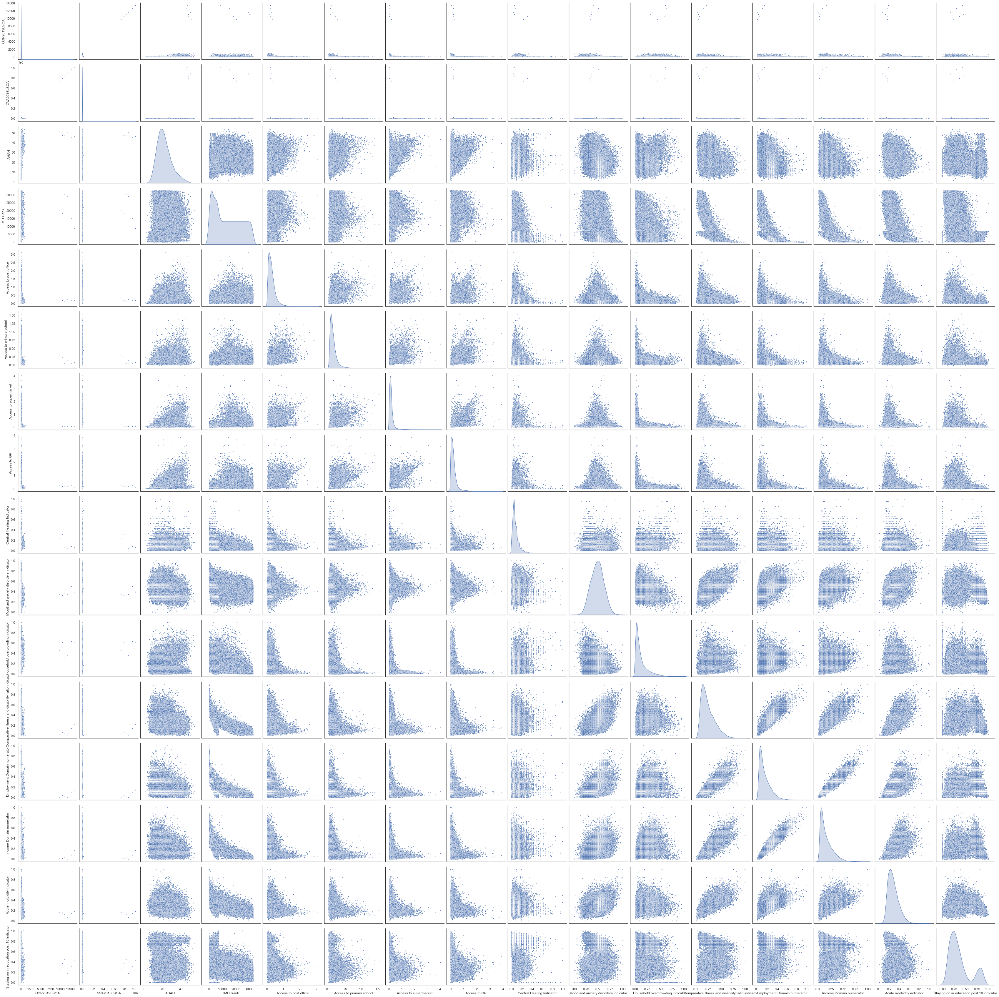

In [34]:
#pairplot of all socioeconomic indicators
cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                'Access to primary school', 'Access to supermarket', 'Access to GP', 'Central Heating Indicator',
               'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 'Comparative illness and disability ratio indicator',
               'Employment Domain numerator', 'Income Domain numerator', 'Staying on in education post 16 indicator']

sns.set(style="white")
sns.pairplot(gdf, 
             vars=cols_to_plot,
             hue=None, markers=".", height=3, diag_kind='kde');

<AxesSubplot:>

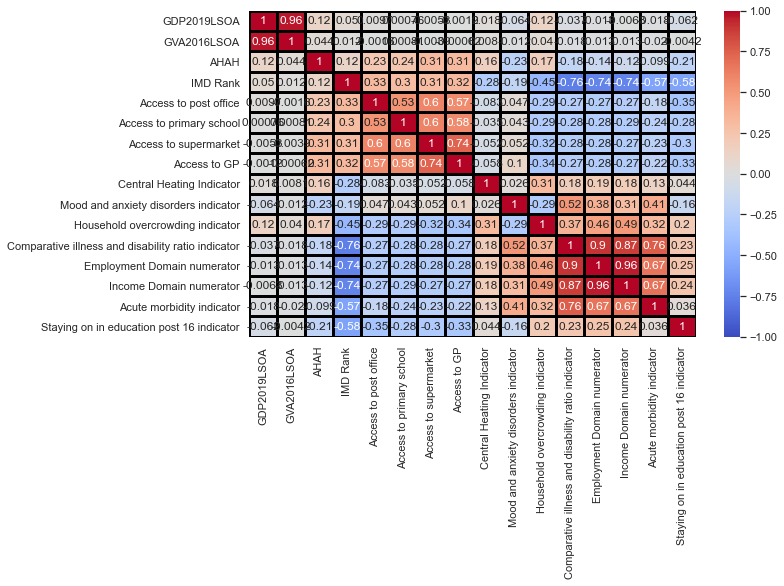

In [35]:
correlation_plot = gdf[['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                'Access to primary school', 'Access to supermarket', 'Access to GP', 'Central Heating Indicator',
               'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 'Comparative illness and disability ratio indicator',
               'Employment Domain numerator', 'Income Domain numerator', 'Staying on in education post 16 indicator']]

sns.heatmap(correlation_plot.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')

## Mapping

In [36]:
#drop geometry column and re-merge to LSOA shapefile

All.drop(['geometry', 'Shape_Leng_y', 'Shape_Area_y', 'Long_y', 'Lat_y'], axis=1, inplace = True)
Allgdf = All.merge(lsoas, how='left', on = 'Code')
Allgdf = gpd.GeoDataFrame(Allgdf, crs = "epsg:27700")
#color_map = plt.cm.get_cmap('viridis')
#reversed_color_map = color_map.reversed()
#plt.colorbar(nod,label="Station Rank",orientation="horizontal", shrink=0.5)
#plt.axis("off")
#Allgdf.plot(column='Populations', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);



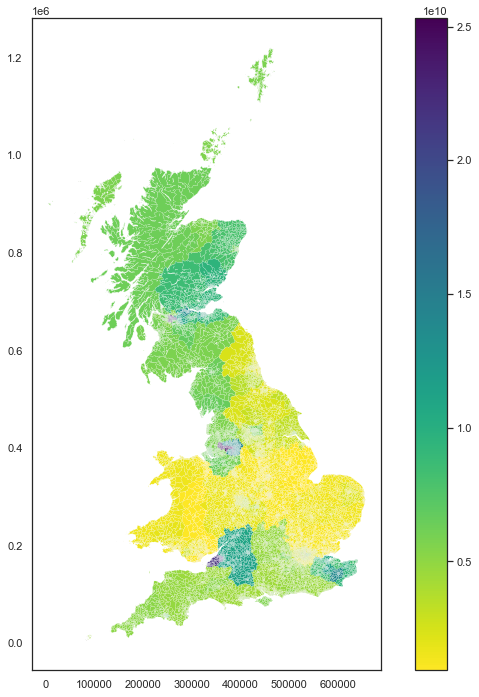

In [37]:
color_map = plt.cm.get_cmap('viridis')
reversed_color_map = color_map.reversed()

Allgdf.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

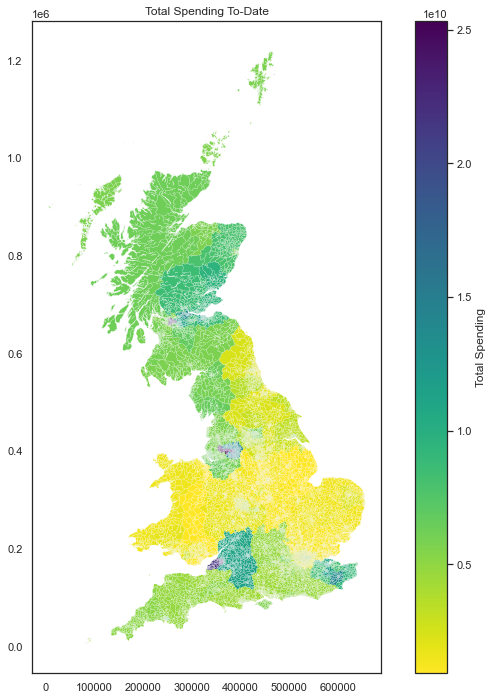

In [106]:
ax = Allgdf.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1,legend_kwds={'label':'Total Spending'});
ax.set_title('Total Spending To-Date')
plt.savefig('ExportedFigures/TotalPastSpendingMap.png',bbox_inches='tight')

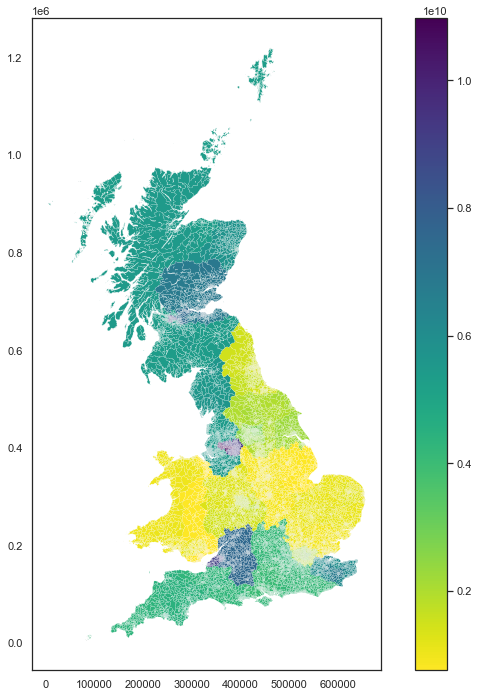

In [39]:
Allgdf.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);


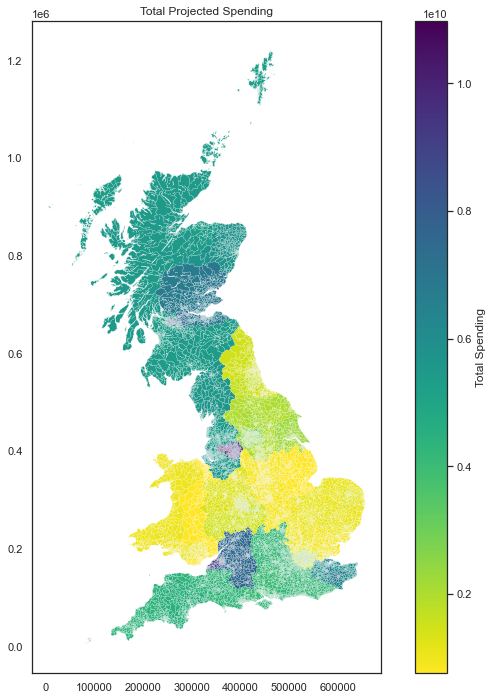

In [107]:
ax = Allgdf.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1,legend_kwds={'label':'Total Spending'});
ax.set_title('Total Projected Spending')
plt.savefig('ExportedFigures/TotalFutureSpendingMap.png',bbox_inches='tight')

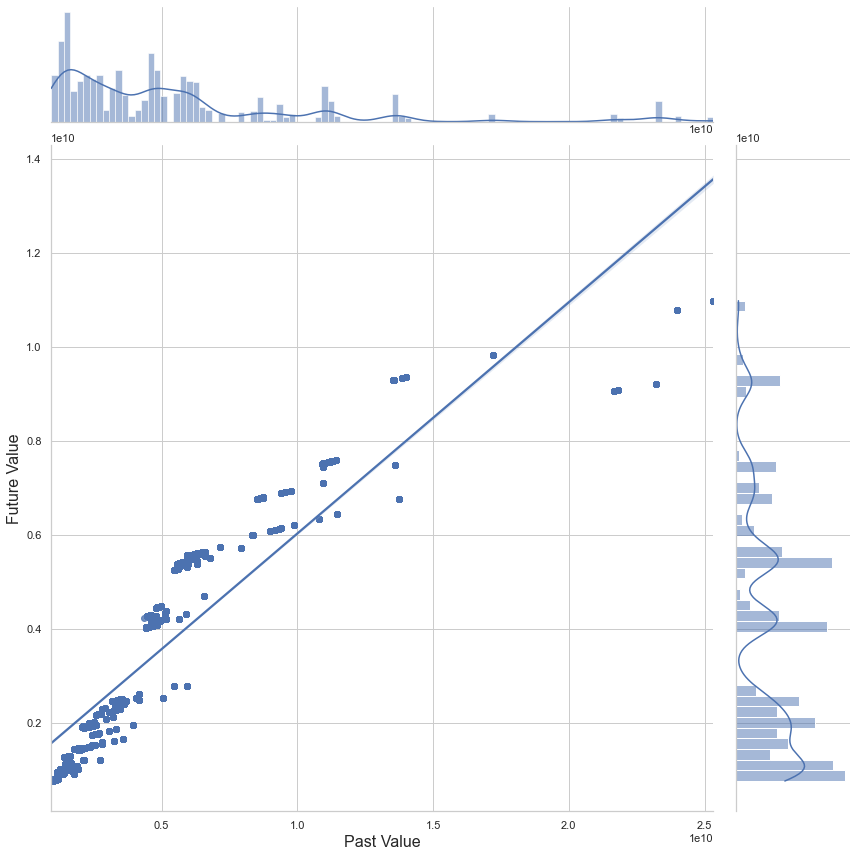

In [41]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='TotalFutureValueSAB', x = 'TotalPastValueSAB', data=Allgdf, kind='reg', height=12)
ax.set_axis_labels(ylabel='Future Value', xlabel='Past Value', fontsize=16)
plt.show()

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:20: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--" (-> color='r'). The keyword argument will take precedence.


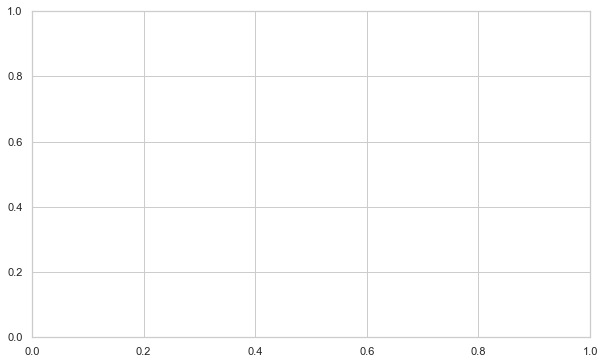

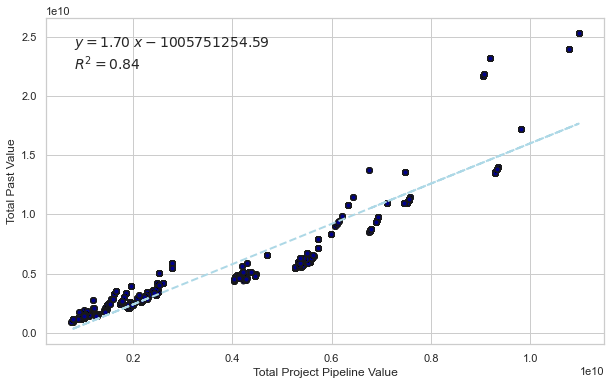

In [42]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1) 
ax.set_facecolor('xkcd:white')


x = Allgdf['TotalFutureValueSAB']
y = Allgdf['TotalPastValueSAB']


#plot graph with rsq and equation of the line

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1) 
ax.set_facecolor('xkcd:white')

plt.plot(x,y,"o", ms=5, mec="k", color = 'darkblue')
z = np.polyfit(x, y, 1)
y_hat = np.poly1d(z)(x)

plt.plot(x, y_hat, "r--", lw=2, color='lightblue')
text = f"$y={z[0]:0.2f}\;x{z[1]:+0.2f}$\n$R^2 = {r2_score(y,y_hat):0.2f}$"
plt.gca().text(0.05, 0.95, text,transform=plt.gca().transAxes,
     fontsize=14, verticalalignment='top')
ax.set_ylabel('Total Past Value')
ax.set_xlabel('Total Project Pipeline Value')

plt.savefig('ExportedFigures/PastvFuturePlot.png',bbox_inches='tight')

In [43]:
# Merge total columns with socioeconomic variables

totaltemp = Allgdf[['TotalPastValueSAB', 'TotalFutureValueSAB', 'LSOA Code', 'geometry']] 

gdf_total = gdf.merge(totaltemp, left_on = 'Code' , right_on = 'LSOA Code', how = 'left')

gdf_total['Average-4year-GDP'] = gdf_total[['GDP2019LSOA','GDP2018LSOA','GDP2017LSOA','GDP2016LSOA']].mean(axis=1)
gdf_total['Average-4year-GVA'] = gdf_total[['GVA2016LSOA','GVA2015LSOA','GVA2014LSOA','GVA2013LSOA']].mean(axis=1)


gdf_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 47 columns):
 #   Column                                              Non-Null Count  Dtype   
---  ------                                              --------------  -----   
 0   index                                               41729 non-null  int64   
 1   Code                                                41729 non-null  object  
 2   LSOA name (2011)                                    34753 non-null  object  
 3   LA Name                                             41729 non-null  object  
 4   Income Domain Rank                                  41729 non-null  float64 
 5   Employment Domain Rank                              41729 non-null  float64 
 6   IMD Rank                                            41729 non-null  int64   
 7   AHAH                                                41729 non-null  float64 
 8   AHAH Rank                                           41729 non-null

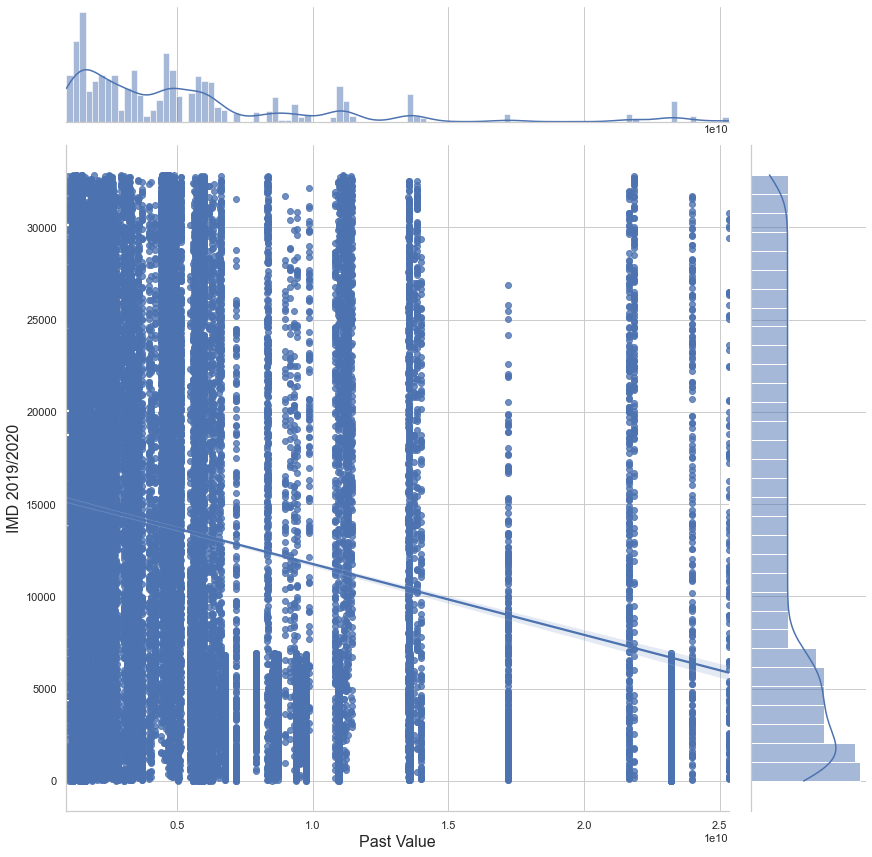

In [44]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='IMD Rank', x = 'TotalPastValueSAB', data=gdf_total, kind='reg', height=12)
ax.set_axis_labels(ylabel='IMD 2019/2020', xlabel='Past Value', fontsize=16)
plt.show()

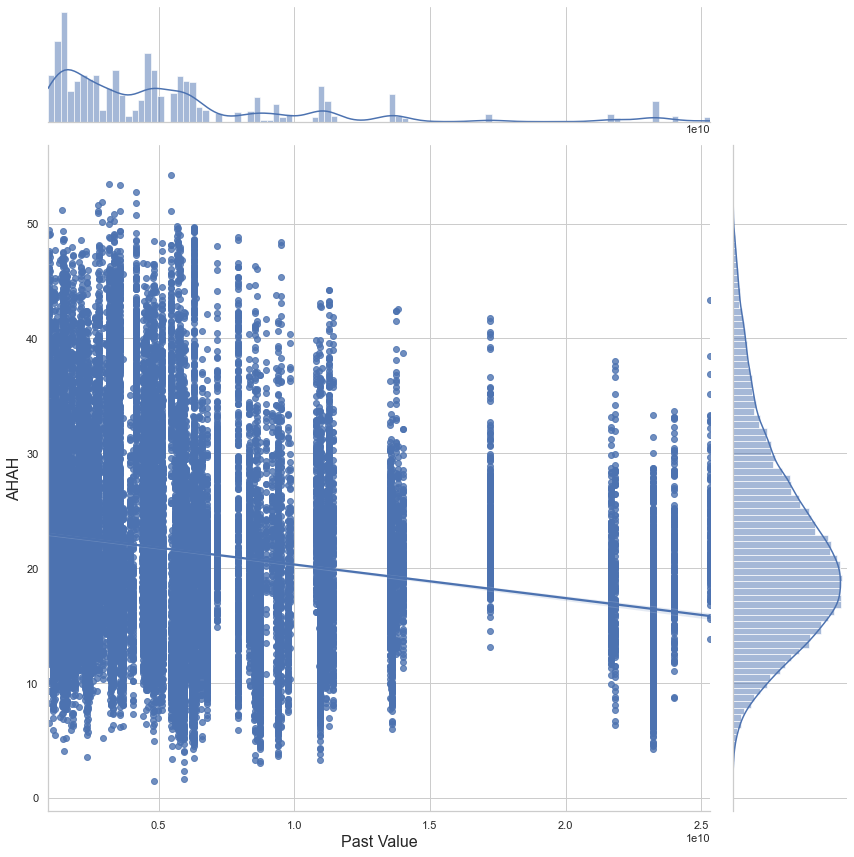

In [45]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='AHAH', x = 'TotalPastValueSAB', data=gdf_total, kind='reg', height=12)
ax.set_axis_labels(ylabel='AHAH', xlabel='Past Value', fontsize=16)
plt.show()

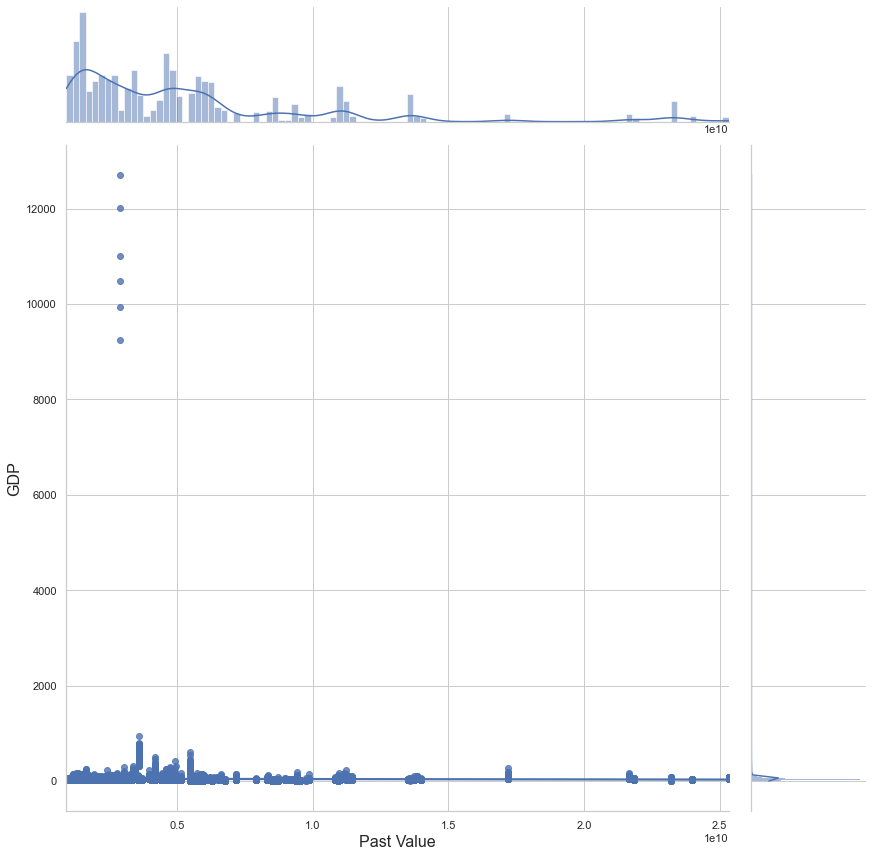

In [46]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='Average-4year-GDP', x = 'TotalPastValueSAB', data=gdf_total, kind='reg', height=12)
ax.set_axis_labels(ylabel='GDP', xlabel='Past Value', fontsize=16)
plt.show()

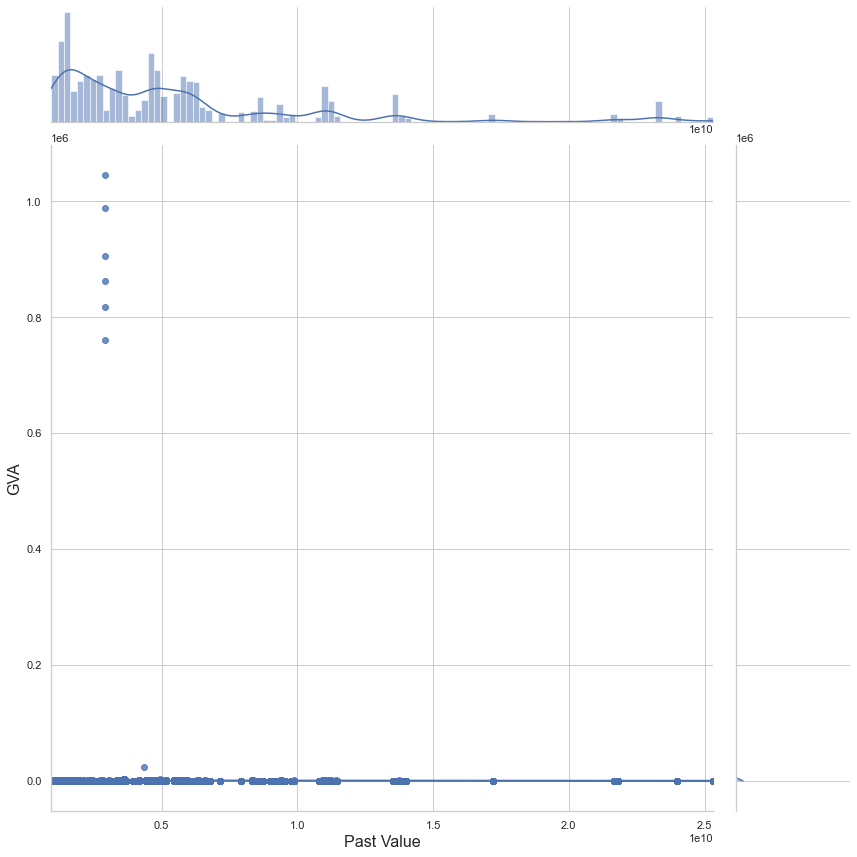

In [47]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='Average-4year-GVA', x = 'TotalPastValueSAB', data=gdf_total, kind='reg', height=12)
ax.set_axis_labels(ylabel='GVA', xlabel='Past Value', fontsize=16)
plt.show()

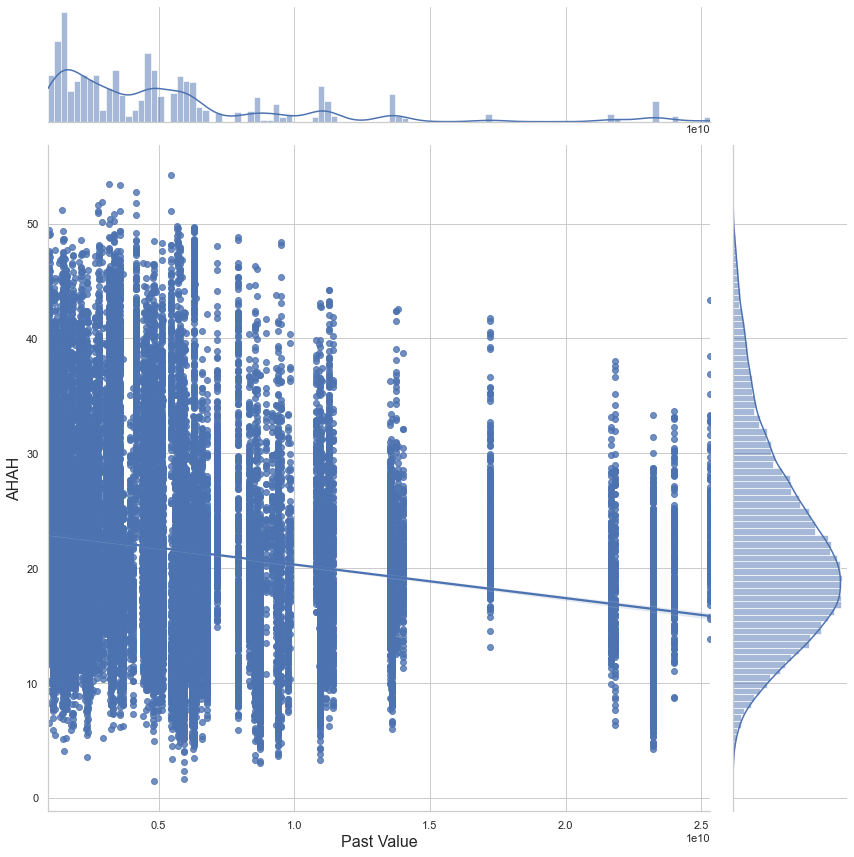

In [48]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='AHAH', x = 'TotalPastValueSAB', data=gdf_total, kind='reg', height=12)
ax.set_axis_labels(ylabel='AHAH', xlabel='Past Value', fontsize=16)
plt.show()

In [49]:
All.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Unnamed: 0                 41729 non-null  int64  
 1   Code                       41729 non-null  object 
 2   FutureValueLSOA            41729 non-null  float64
 3   PastValueLSOA              41729 non-null  float64
 4   LSOA Code                  41729 non-null  object 
 5   LSOA Name                  41729 non-null  object 
 6   LA Code (2019 boundaries)  41729 non-null  object 
 7   LA name (2019 boundaries)  41729 non-null  object 
 8   NUTS3 Name                 41277 non-null  object 
 9   NUTS2 Name                 41729 non-null  object 
 10  NUTS1 Name                 41729 non-null  object 
 11  FutureValueSAB_1           41729 non-null  float64
 12  PastValueSAB_1             41729 non-null  float64
 13  Populations                41729 non-null  int

In [50]:
#Export total spending 
Spendingtotal = All[['Code','TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr','PastValueSAB_GE','FutureValueSAB_GE',
                     'PastValueSAB_P','FutureValueSAB_P','PastValueSAB_S','FutureValueSAB_S','PastValueSAB_Un' ,'FutureValueSAB_Un',
                     'PastValueSAB_LH','FutureValueSAB_LH','PastValueSAB_H','FutureValueSAB_H','PastValueSAB_Ut','FutureValueSAB_Ut',
                    'TotalPastValueSAB','TotalFutureValueSAB']]

Spendingtotal.to_csv('ExportedData/Spendingtotal.csv')

# Spending per head

In [51]:
#drop old populations column

Allgdf.drop(['Populations'], axis=1, inplace = True)

#create new dataframe of spending and code

Spending_perhead = Allgdf[['Code', 'FutureValueSAB_1', 'PastValueSAB_1', 'PastValueSAB_2' , 'FutureValueSAB_2', 'PastValueSAB_3' ,
                          'FutureValueSAB_3', 'TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr','PastValueSAB_GE','FutureValueSAB_GE',
                          'PastValueSAB_P','FutureValueSAB_P','PastValueSAB_S','FutureValueSAB_S','PastValueSAB_Un' ,'FutureValueSAB_Un',
                          'PastValueSAB_LH','FutureValueSAB_LH','PastValueSAB_H','FutureValueSAB_H','PastValueSAB_Ut','FutureValueSAB_Ut',
                          'TotalPastValueSAB','TotalFutureValueSAB','geometry']]


In [52]:
#merge with populations

Spending_perhead = Spending_perhead.merge(populations, how = "left", left_on = 'Code', right_on = "LSOA Code")

In [53]:
columns = ['FutureValueSAB_1', 'PastValueSAB_1', 'PastValueSAB_2' , 'FutureValueSAB_2', 'PastValueSAB_3' ,
            'FutureValueSAB_3', 'TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr','PastValueSAB_GE','FutureValueSAB_GE',
             'PastValueSAB_P','FutureValueSAB_P','PastValueSAB_S','FutureValueSAB_S','PastValueSAB_Un' ,'FutureValueSAB_Un',
             'PastValueSAB_LH','FutureValueSAB_LH','PastValueSAB_H','FutureValueSAB_H','PastValueSAB_Ut','FutureValueSAB_Ut',
             'TotalPastValueSAB','TotalFutureValueSAB']

Spending_perhead[columns] = Spending_perhead[columns].div(Spending_perhead['All Ages'],axis = 0)
Spending_perhead.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Code                    41729 non-null  object  
 1   FutureValueSAB_1        41729 non-null  float64 
 2   PastValueSAB_1          41729 non-null  float64 
 3   PastValueSAB_2          41729 non-null  float64 
 4   FutureValueSAB_2        41729 non-null  float64 
 5   PastValueSAB_3          41729 non-null  float64 
 6   FutureValueSAB_3        41729 non-null  float64 
 7   TotalPastValueSAB_Tr    41729 non-null  float64 
 8   TotalFutureValueSAB_Tr  41729 non-null  float64 
 9   PastValueSAB_GE         41729 non-null  float64 
 10  FutureValueSAB_GE       41729 non-null  float64 
 11  PastValueSAB_P          41729 non-null  float64 
 12  FutureValueSAB_P        41729 non-null  float64 
 13  PastValueSAB_S          41729 non-null  float64 
 14  FutureValueSAB

In [54]:
Spending_perhead.head()

,Code,FutureValueSAB_1,PastValueSAB_1,PastValueSAB_2,FutureValueSAB_2,PastValueSAB_3,FutureValueSAB_3,TotalPastValueSAB_Tr,TotalFutureValueSAB_Tr,PastValueSAB_GE,...,PastValueSAB_H,FutureValueSAB_H,PastValueSAB_Ut,FutureValueSAB_Ut,TotalPastValueSAB,TotalFutureValueSAB,geometry,LSOA Code,LSOA Name,All Ages
0,E01000001,0.06,"10,970.74","307,640.33",3.17,"1,088,263.27",9.94,"1,406,874.34",13.17,"10,970.74",...,"10,970.74",0.06,"10,970.74",0.06,"1,780,339.09","1,406,877.87","POLYGON ((532151.537 181867.433, 532152.500 18...",E01000001,City of London 001A,1636
1,E01000002,0.06,"11,519.98","323,042.09",3.33,"1,142,746.29",10.43,"1,477,308.35",13.83,"11,519.98",...,"11,519.98",0.06,"11,519.98",0.06,"1,869,470.32","1,477,312.07","POLYGON ((532634.497 181926.016, 532632.048 18...",E01000002,City of London 001B,1558
2,E01000003,0.06,"10,049.34","281,802.67",2.90,"996,863.78",9.10,"1,288,715.80",12.06,"10,049.34",...,"10,049.34",0.06,"10,049.34",0.06,"1,630,814.53","1,288,719.04","POLYGON ((532153.703 182165.155, 532158.250 18...",E01000003,City of London 001C,1786
3,E01000005,0.05,"9,506.42","266,578.16",2.75,"943,007.79",8.61,"1,219,092.38",11.41,"9,506.42",...,"9,506.42",0.05,"9,506.42",0.05,"1,542,709.09","1,219,095.45","POLYGON ((533619.062 181402.364, 533639.868 18...",E01000005,City of London 001E,1888
4,E01032739,0.07,"13,053.18","366,036.05",3.77,"1,294,835.43",11.82,"1,673,924.67",15.67,"13,053.18",...,"13,053.18",0.07,"13,053.18",0.07,"2,118,279.82","1,673,928.87","POLYGON ((533376.156 181863.888, 533372.156 18...",E01032739,City of London 001F,1375


In [55]:
Spending_perhead = gpd.GeoDataFrame(Spending_perhead, crs = "epsg:27700")

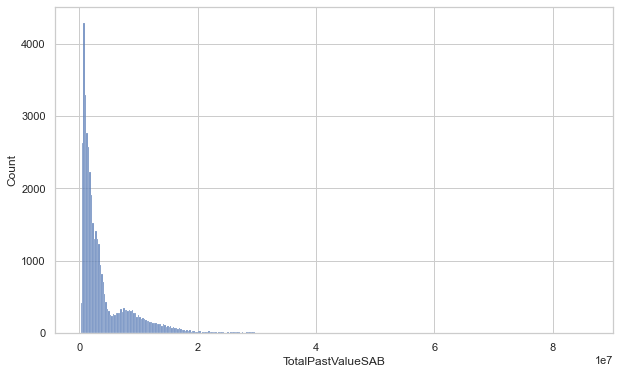

In [56]:
#plot histogram of past spending

sns.histplot(data=Spending_perhead, x="TotalPastValueSAB")
plt.savefig('ExportedFigures/PastSpendingHistogram.png',bbox_inches='tight')

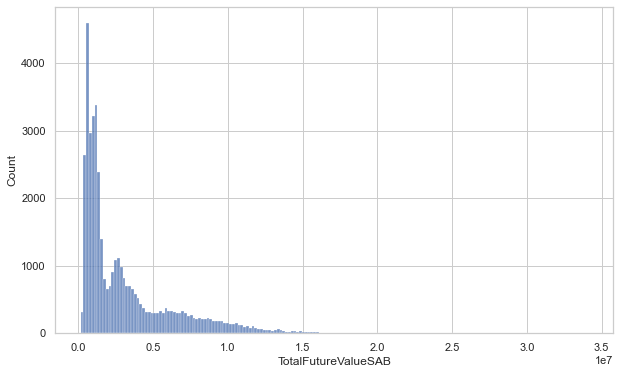

In [57]:
#plot histogram of future spending

sns.histplot(data=Spending_perhead, x="TotalFutureValueSAB")
plt.savefig('ExportedFigures/FutureSpendingHistogram.png',bbox_inches='tight')

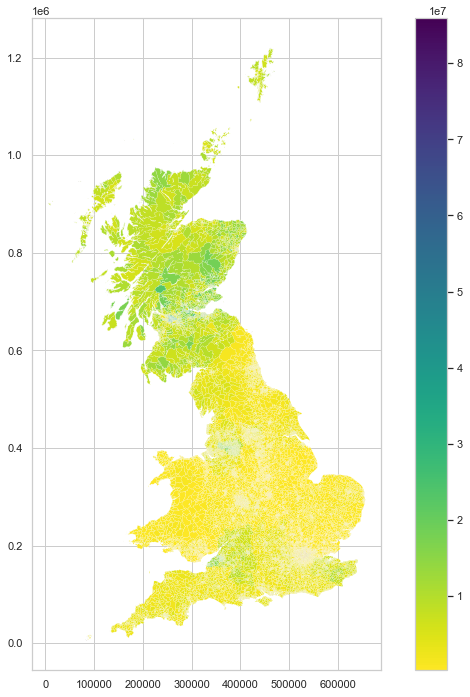

In [58]:
Spending_perhead.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/PastSpendingperHead.png',bbox_inches='tight')

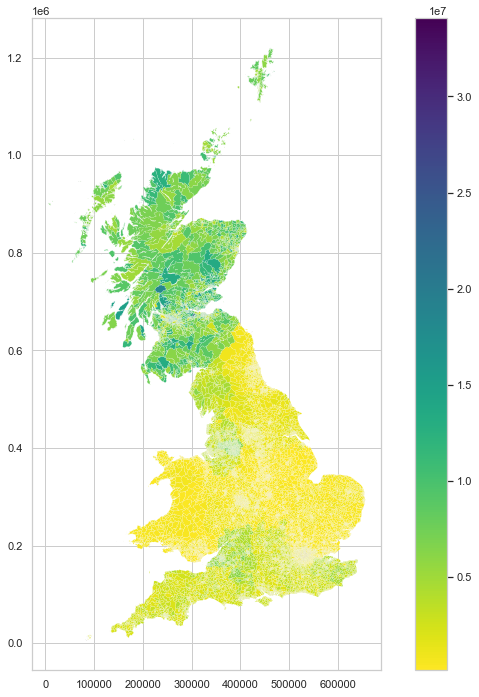

In [59]:
Spending_perhead.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/FutureSpendingperHead.png',bbox_inches='tight')

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:20: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--" (-> color='r'). The keyword argument will take precedence.


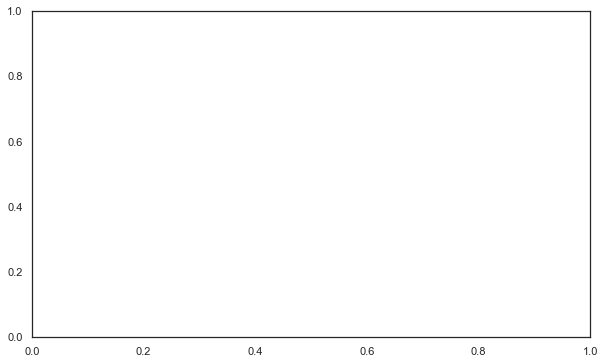

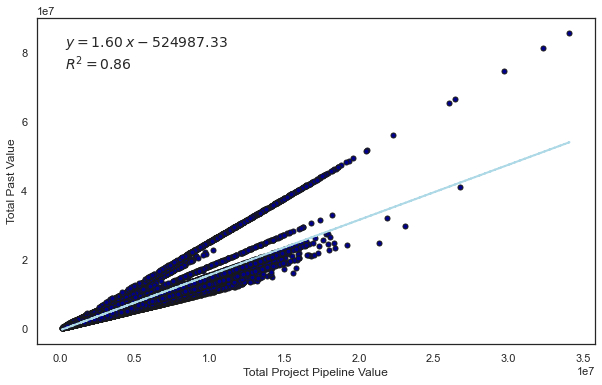

In [105]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1) 
ax.set_facecolor('xkcd:white')


x = Spending_perhead['TotalFutureValueSAB']
y = Spending_perhead['TotalPastValueSAB']


#plot graph with rsq and equation of the line

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1) 
ax.set_facecolor('xkcd:white')

plt.plot(x,y,"o", ms=5, mec="k", color = 'darkblue')
z = np.polyfit(x, y, 1)
y_hat = np.poly1d(z)(x)

plt.plot(x, y_hat, "r--", lw=2, color='lightblue')
text = f"$y={z[0]:0.2f}\;x{z[1]:+0.2f}$\n$R^2 = {r2_score(y,y_hat):0.2f}$"
plt.gca().text(0.05, 0.95, text,transform=plt.gca().transAxes,
     fontsize=14, verticalalignment='top')
ax.set_ylabel('Total Past Value')
ax.set_xlabel('Total Project Pipeline Value')

plt.savefig('ExportedFigures/PastvFuturePlotSpendingperhead.png',bbox_inches='tight')

# Relationships by Category

## Transport

In [62]:
transport_cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                          'Access to primary school', 'Access to supermarket', 'Access to GP', 'Employment Domain numerator', 
                          'Income Domain numerator']

In [63]:
# Transport - all access indicators

#Normalise all access indicators
mms = MinMaxScaler(feature_range=(-1,1))

gdf_transport = gdf[['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                    'Access to primary school', 'Access to supermarket', 'Access to GP', 'Employment Domain numerator', 
                    'Income Domain numerator']]

for c in gdf_transport.columns.values:
    gdf_transport[c] = mms.fit_transform(gdf_transport[c].values.reshape(-1,1))
    
#append LSOA code back onto dataframe
gdf_transport['Code'] = gdf['Code']

    
gdf_transport.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:11: SettingW

,GDP2019LSOA,GVA2016LSOA,AHAH,IMD Rank,Access to post office,Access to primary school,Access to supermarket,Access to GP,Employment Domain numerator,Income Domain numerator,Code
0,0.73,0.73,0.84,0.78,-0.82,-0.82,-0.97,-0.91,-1.00,-1.00,E01000001
1,0.65,0.65,0.76,0.85,-0.92,-0.92,-0.97,-0.89,-0.96,-0.94,E01000002
2,0.89,0.89,0.66,-0.09,-0.86,-0.90,-0.97,-0.88,-0.79,-0.84,E01000003


In [64]:
#merge with infrastructure data

Transporttemp = Allgdf[['LSOA Code', 'TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr', 'geometry']]

gdf_transport = gdf_transport.merge(Transporttemp, left_on = 'Code' , right_on = 'LSOA Code', how = 'left')
gdf_transport.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   GDP2019LSOA                  40988 non-null  float64 
 1   GVA2016LSOA                  39070 non-null  float64 
 2   AHAH                         41729 non-null  float64 
 3   IMD Rank                     41729 non-null  float64 
 4   Access to post office        39820 non-null  float64 
 5   Access to primary school     39820 non-null  float64 
 6   Access to supermarket        39820 non-null  float64 
 7   Access to GP                 39820 non-null  float64 
 8   Employment Domain numerator  39820 non-null  float64 
 9   Income Domain numerator      39820 non-null  float64 
 10  Code                         41729 non-null  object  
 11  LSOA Code                    41729 non-null  object  
 12  TotalPastValueSAB_Tr         41729 non-null  float64 
 13  T

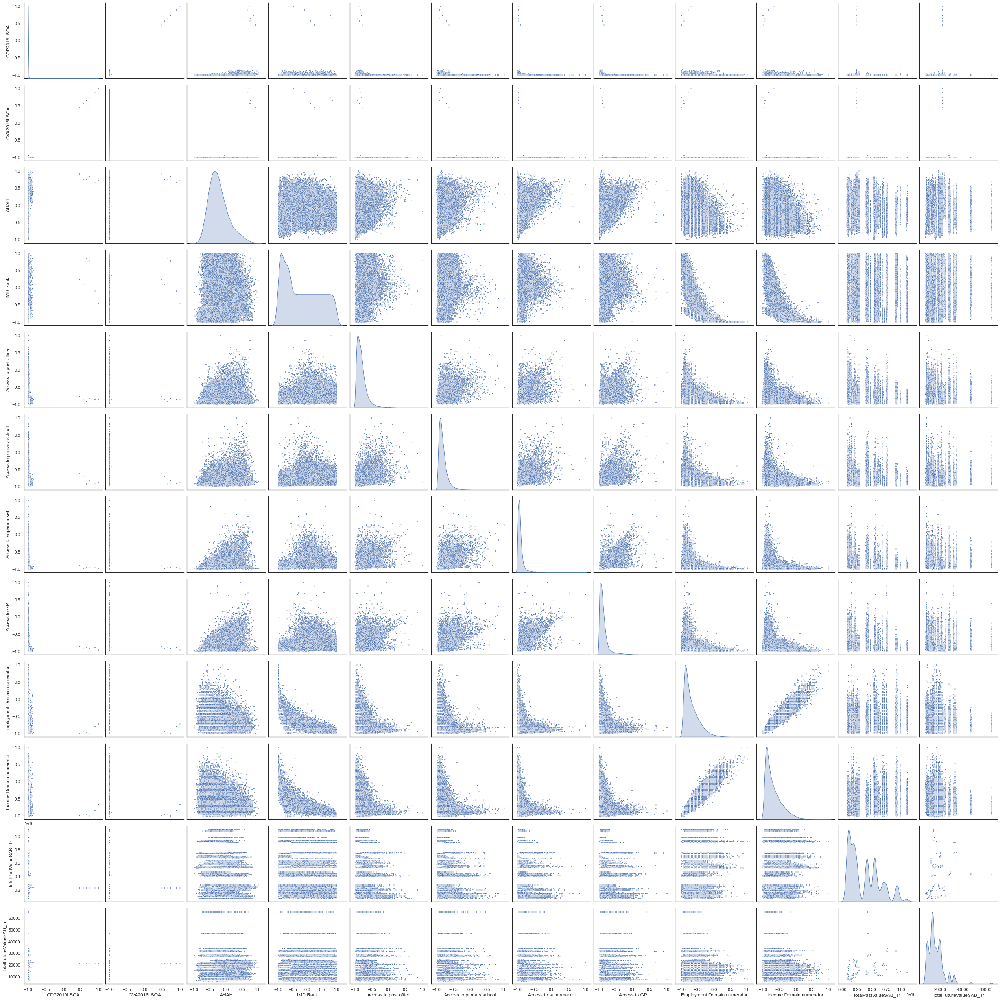

In [65]:
#pairplot of all socioeconomic indicators
cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                'Access to primary school', 'Access to supermarket', 'Access to GP', 'Employment Domain numerator', 
                'Income Domain numerator', 'TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr']

sns.set(style="white")
sns.pairplot(gdf_transport, 
             vars=cols_to_plot,
             hue=None, markers=".", height=3, diag_kind='kde');

<AxesSubplot:>

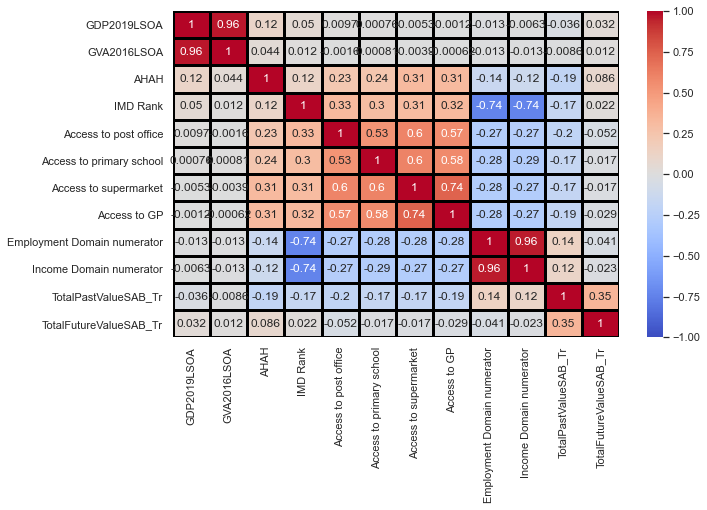

In [66]:
cols_to_plot = gdf_transport[['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                'Access to primary school', 'Access to supermarket', 'Access to GP', 'Employment Domain numerator', 
                'Income Domain numerator', 'TotalPastValueSAB_Tr','TotalFutureValueSAB_Tr']]

sns.heatmap(cols_to_plot.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')

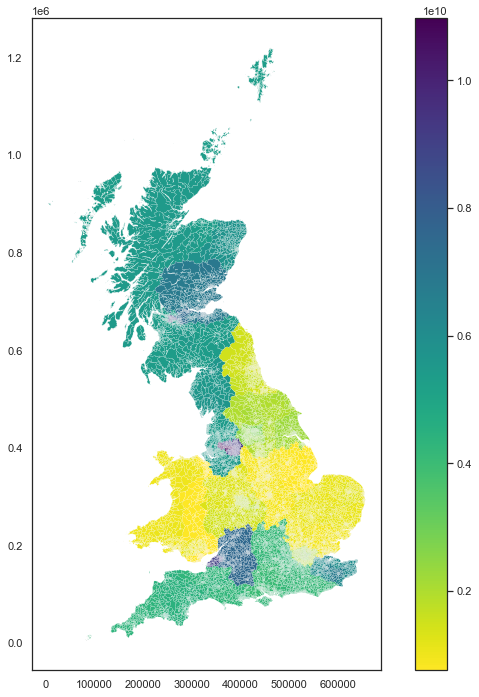

In [67]:
#create gdf

gdf_transport = gpd.GeoDataFrame(gdf_transport, crs = "epsg:27700")

gdf_transport.plot(column='TotalPastValueSAB_Tr', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

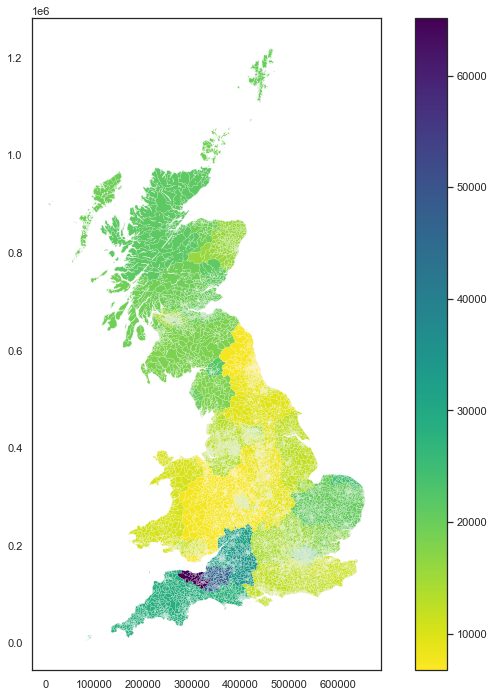

In [68]:
gdf_transport.plot(column='TotalFutureValueSAB_Tr', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

## Health

In [69]:
health_cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to GP', 'Central Heating Indicator', 
                       'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 
                       'Comparative illness and disability ratio indicator']


In [70]:
#Normalise all access indicators
mms = MinMaxScaler(feature_range=(-1,1))

gdf_health = gdf[['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to GP', 'Central Heating Indicator', 
                  'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 
                  'Comparative illness and disability ratio indicator']]

for c in gdf_health.columns.values:
    gdf_health[c] = mms.fit_transform(gdf_health[c].values.reshape(-1,1))
    
gdf_health['Code'] = gdf['Code']
    
gdf_health.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

,GDP2019LSOA,GVA2016LSOA,AHAH,IMD Rank,Access to GP,Central Heating Indicator,Mood and anxiety disorders indicator,Household overcrowding indicator,Comparative illness and disability ratio indicator,Acute morbidity indicator,Code
0,0.73,0.73,0.84,0.78,-0.91,-0.93,-0.30,-0.27,-0.97,-0.87,E01000001
1,0.65,0.65,0.76,0.85,-0.89,-0.89,-0.27,-0.38,-0.92,-0.75,E01000002
2,0.89,0.89,0.66,-0.09,-0.88,-0.84,0.01,0.26,-0.72,-0.70,E01000003


In [71]:
#Create health total columns

Allgdf['PastValueSAB_Health'] = Allgdf['PastValueSAB_LH'] + Allgdf['PastValueSAB_H']

Allgdf['FutureValueSAB_Health'] = Allgdf['FutureValueSAB_LH'] + Allgdf['FutureValueSAB_H']

Healthtemp = Allgdf[['LSOA Code', 'PastValueSAB_Health','FutureValueSAB_Health', 'geometry']]

gdf_health = gdf_health.merge(Healthtemp, left_on = 'Code' , right_on = 'LSOA Code', how = 'left')


gdf_health.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 15 columns):
 #   Column                                              Non-Null Count  Dtype   
---  ------                                              --------------  -----   
 0   GDP2019LSOA                                         40988 non-null  float64 
 1   GVA2016LSOA                                         39070 non-null  float64 
 2   AHAH                                                41729 non-null  float64 
 3   IMD Rank                                            41729 non-null  float64 
 4   Access to GP                                        39820 non-null  float64 
 5   Central Heating Indicator                           39820 non-null  float64 
 6   Mood and anxiety disorders indicator                39820 non-null  float64 
 7   Household overcrowding indicator                    39820 non-null  float64 
 8   Comparative illness and disability ratio indicator  39820 non-null

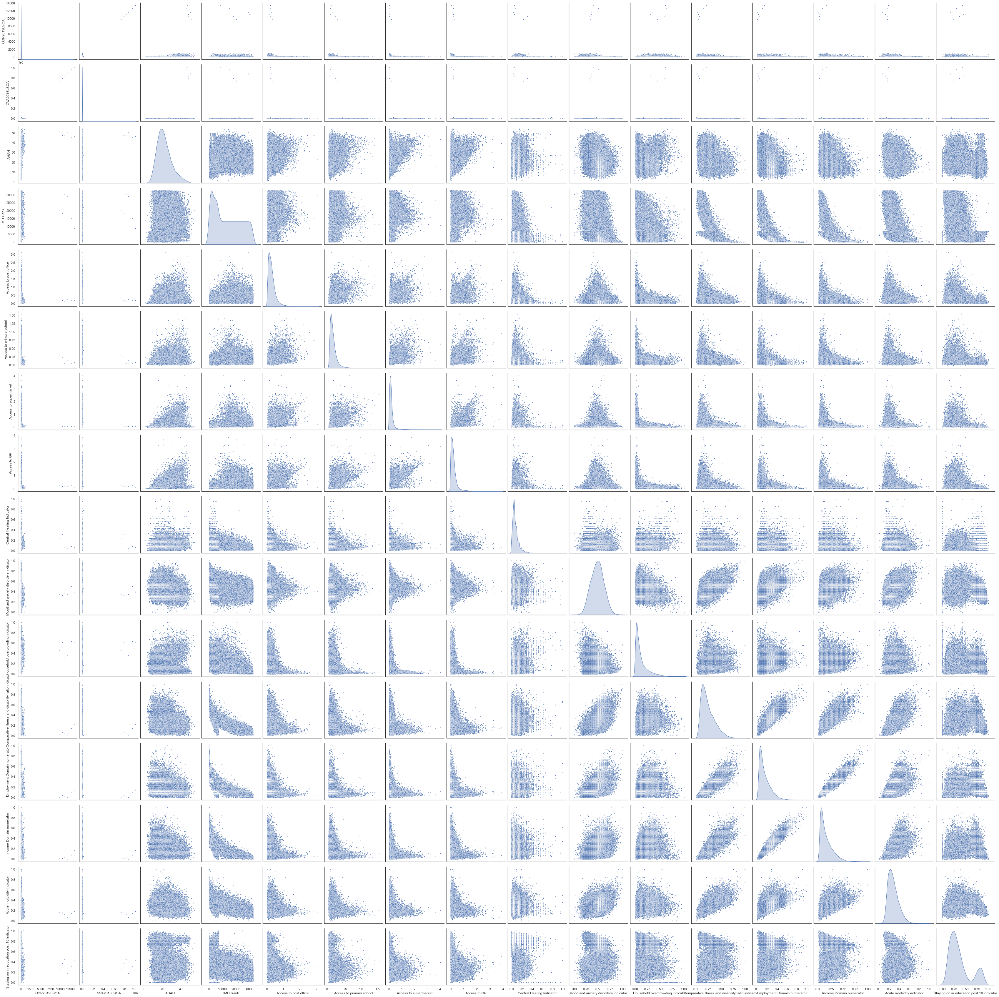

In [72]:
#pairplot of all socioeconomic indicators
cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to post office', 
                'Access to primary school', 'Access to supermarket', 'Access to GP', 'Central Heating Indicator',
               'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 'Comparative illness and disability ratio indicator',
               'Employment Domain numerator', 'Income Domain numerator', 'Staying on in education post 16 indicator']

sns.set(style="white")
sns.pairplot(gdf, 
             vars=cols_to_plot,
             hue=None, markers=".", height=3, diag_kind='kde');

<AxesSubplot:>

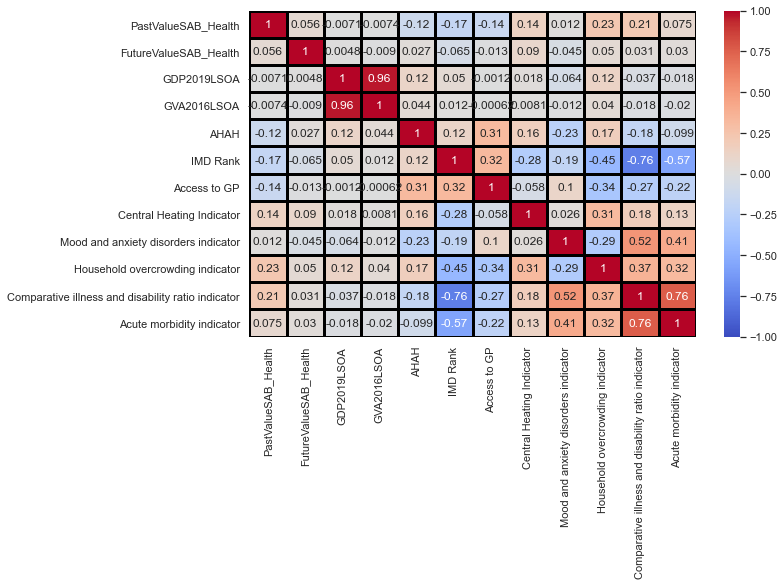

In [73]:
cols_to_plot = gdf_health[['PastValueSAB_Health', 'FutureValueSAB_Health', 'GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Access to GP', 'Central Heating Indicator', 
                  'Mood and anxiety disorders indicator', 'Household overcrowding indicator', 
                  'Comparative illness and disability ratio indicator']]

sns.heatmap(cols_to_plot.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')

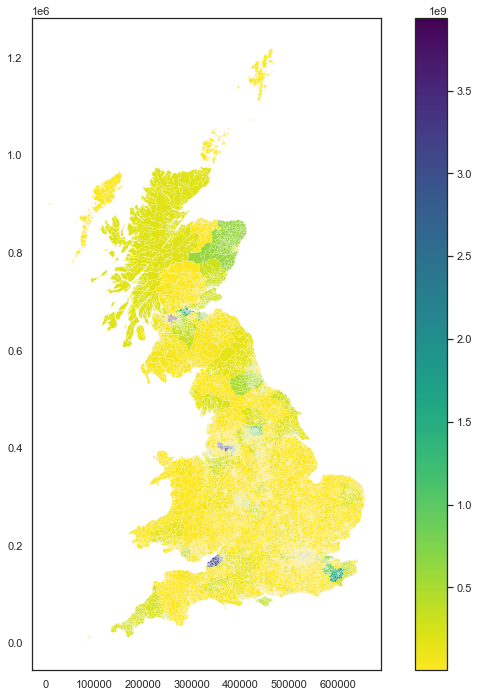

In [74]:
gdf_health = gpd.GeoDataFrame(gdf_health, crs = "epsg:27700")

gdf_health.plot(column='PastValueSAB_Health', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

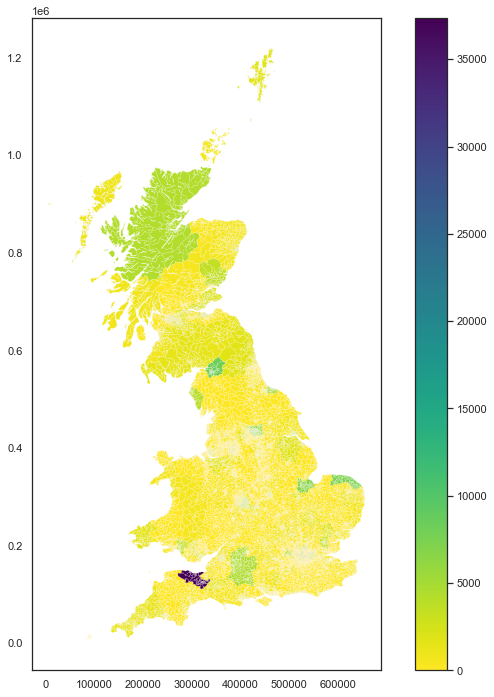

In [75]:
gdf_health.plot(column='FutureValueSAB_Health', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

## Education

In [76]:
education_cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 
                          'Access to primary school', 'Employment Domain numerator', 
                          'Income Domain numerator', 'Staying on in education post 16 indicator']


In [77]:
#Normalise all access indicators
mms = MinMaxScaler(feature_range=(-1,1))

gdf_education = gdf[['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 
                     'Access to primary school', 'Employment Domain numerator', 
                     'Income Domain numerator', 'Staying on in education post 16 indicator']]

for c in gdf_education.columns.values:
    gdf_education[c] = mms.fit_transform(gdf_education[c].values.reshape(-1,1))
    
    
gdf_education['Code'] = gdf['Code']
    
gdf_education.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

,GDP2019LSOA,GVA2016LSOA,AHAH,IMD Rank,Access to primary school,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator,Code
0,0.73,0.73,0.84,0.78,-0.82,-1.00,-1.00,-0.66,E01000001
1,0.65,0.65,0.76,0.85,-0.92,-0.96,-0.94,-0.10,E01000002
2,0.89,0.89,0.66,-0.09,-0.90,-0.79,-0.84,-0.39,E01000003


In [78]:
#Create health total columns

Allgdf['PastValueSAB_Education'] = Allgdf['PastValueSAB_Un'] + Allgdf['PastValueSAB_S'] + Allgdf['PastValueSAB_P']

Allgdf['FutureValueSAB_Education'] = Allgdf['FutureValueSAB_Un'] + Allgdf['FutureValueSAB_S'] + Allgdf['FutureValueSAB_P']

Edutemp = Allgdf[['LSOA Code', 'PastValueSAB_Education','FutureValueSAB_Education', 'geometry']]

gdf_education = gdf_education.merge(Edutemp, left_on = 'Code' , right_on = 'LSOA Code', how = 'left')
gdf_education.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 13 columns):
 #   Column                                     Non-Null Count  Dtype   
---  ------                                     --------------  -----   
 0   GDP2019LSOA                                40988 non-null  float64 
 1   GVA2016LSOA                                39070 non-null  float64 
 2   AHAH                                       41729 non-null  float64 
 3   IMD Rank                                   41729 non-null  float64 
 4   Access to primary school                   39820 non-null  float64 
 5   Employment Domain numerator                39820 non-null  float64 
 6   Income Domain numerator                    39820 non-null  float64 
 7   Staying on in education post 16 indicator  39820 non-null  float64 
 8   Code                                       41729 non-null  object  
 9   LSOA Code                                  41729 non-null  object  
 10  PastValueS

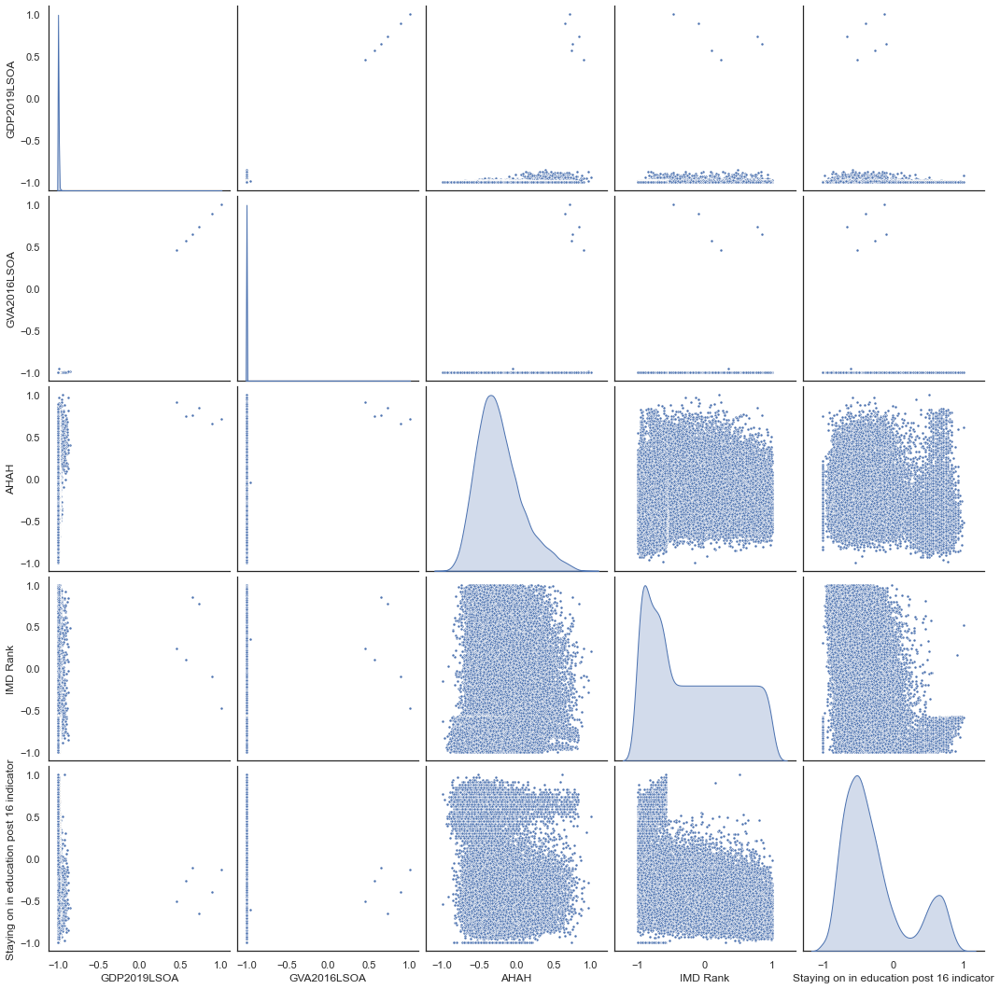

In [79]:
#pairplot of all socioeconomic indicators
cols_to_plot = ['GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Staying on in education post 16 indicator']

sns.set(style="white")
sns.pairplot(gdf_education, 
             vars=cols_to_plot,
             hue=None, markers=".", height=3, diag_kind='kde');

<AxesSubplot:>

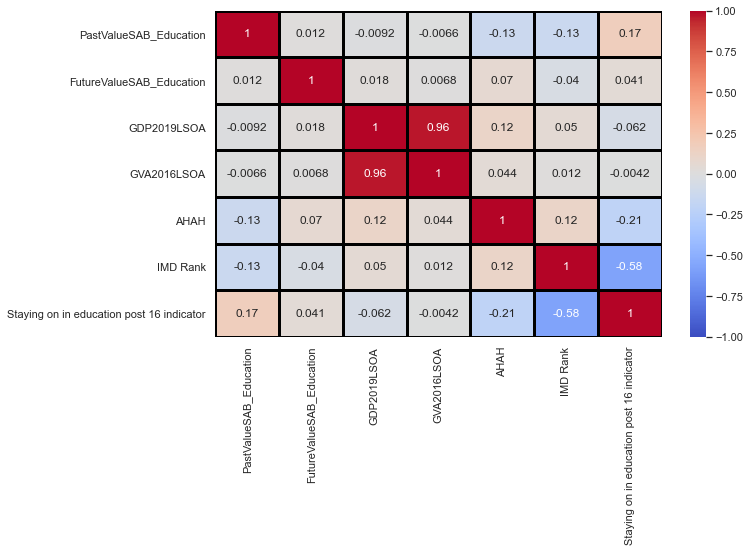

In [80]:
cols_to_plot = gdf_education[['PastValueSAB_Education', 'FutureValueSAB_Education', 'GDP2019LSOA', 'GVA2016LSOA', 'AHAH', 'IMD Rank', 'Staying on in education post 16 indicator']]

sns.heatmap(cols_to_plot.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')

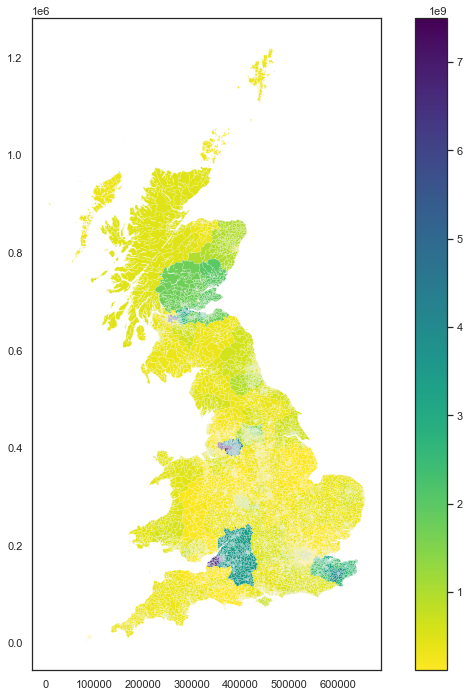

In [81]:
gdf_education = gpd.GeoDataFrame(gdf_education, crs = "epsg:27700")

gdf_education.plot(column='PastValueSAB_Education', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

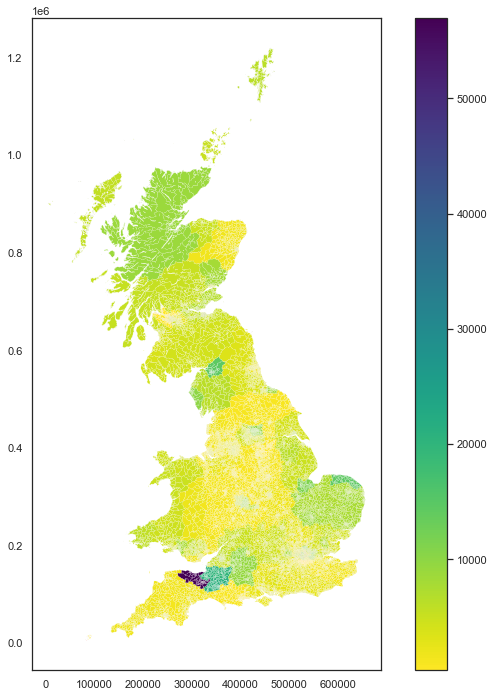

In [82]:
gdf_education.plot(column='FutureValueSAB_Education', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

# Looking at London

In [83]:
Allgdf_london = Allgdf[Allgdf['NUTS1 Name'] == "London"]

gdf_london = gdf[gdf['NUTS1 Name'] == "London"]

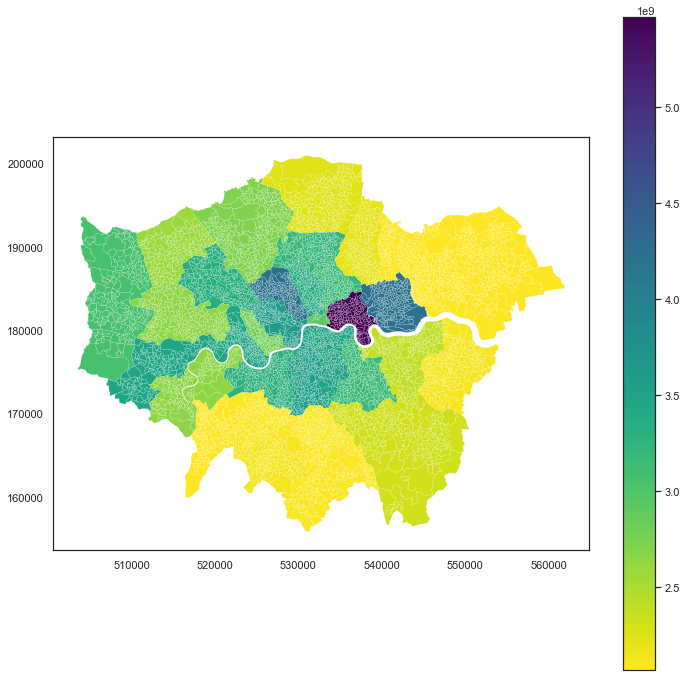

In [96]:
Allgdf_london.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/TotalPastSpendingLondon.png',bbox_inches='tight')

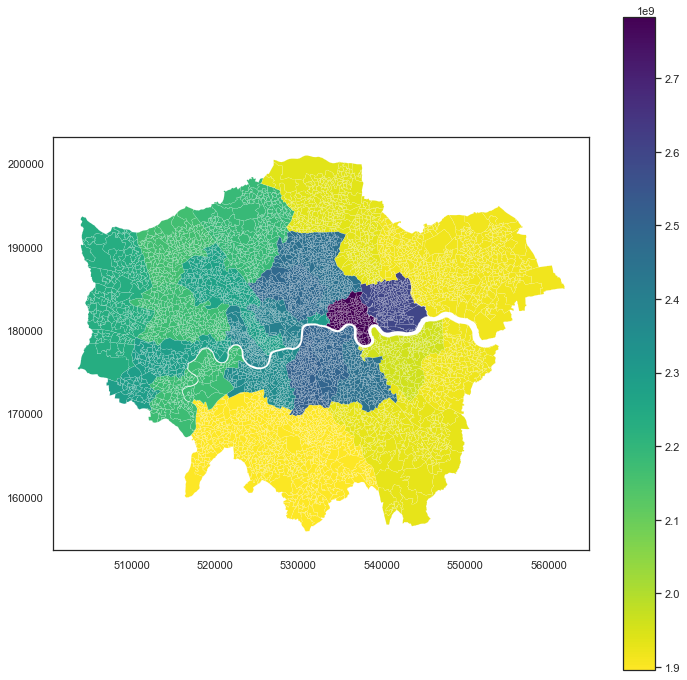

In [97]:
Allgdf_london.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/TotalFutureSpendingLondon.png',bbox_inches='tight')

In [101]:
NUTSlookupsforspendph = Allgdf[['LSOA Code', 'NUTS1 Name', 'NUTS2 Name', 'NUTS3 Name']]
Spending_perhead  = Spending_perhead.merge(NUTSlookupsforspendph, how = "left", right_on="LSOA Code", left_on = "Code")

Spending_perhead_london = Spending_perhead[Spending_perhead['NUTS1 Name'] == "London"]

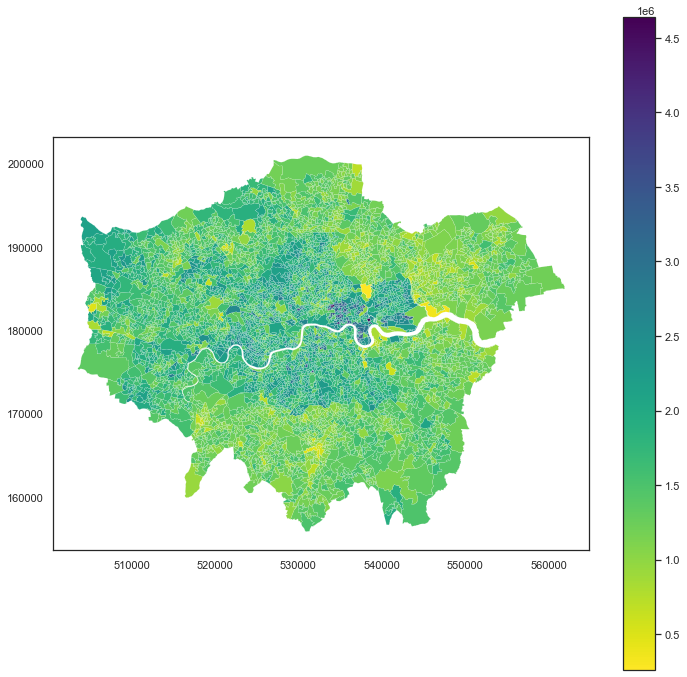

In [103]:
# Spending per head

Spending_perhead_london.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/PastSpendingperHeadLondon.png',bbox_inches='tight')

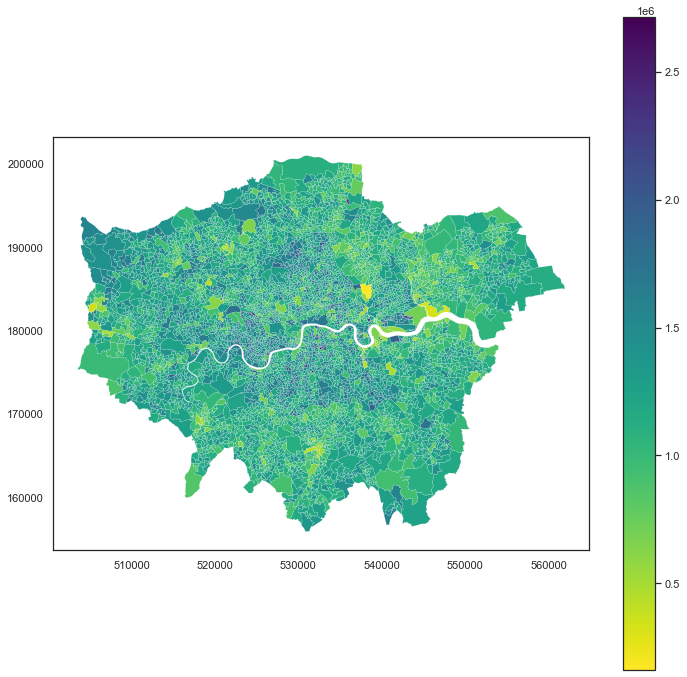

In [104]:
# Spending per head

Spending_perhead_london.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);
plt.savefig('ExportedFigures/FutureSpendingperHeadLondon.png',bbox_inches='tight')

# Looking at North

In [86]:
Allgdf_nwengland = Allgdf[Allgdf['NUTS1 Name'] == "North West (England)"]

gdf_nwengland = gdf[gdf['NUTS1 Name'] == "North West (England)"]

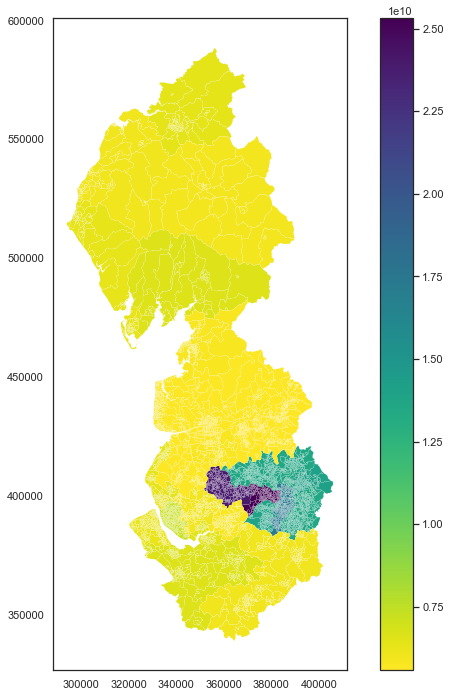

In [87]:
Allgdf_nwengland.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

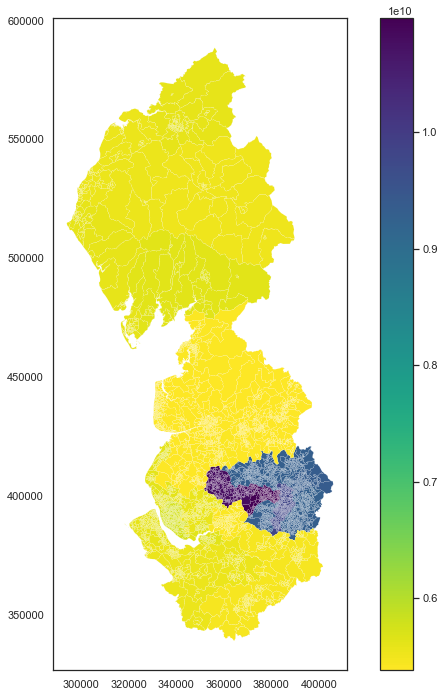

In [88]:
Allgdf_nwengland.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

In [89]:
Allgdf_neengland = Allgdf[Allgdf['NUTS1 Name'] == "North East (England)"]

gdf_neengland = gdf[gdf['NUTS1 Name'] == "North East (England)"]

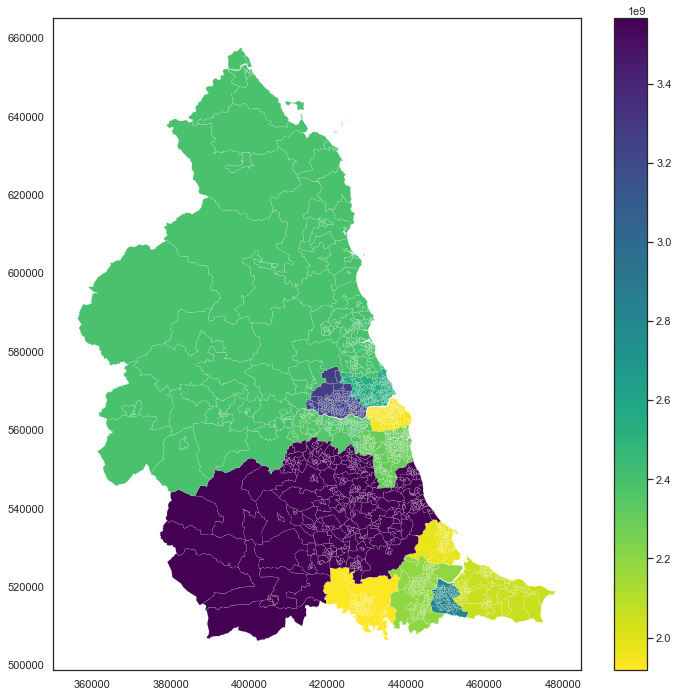

In [90]:
Allgdf_neengland.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

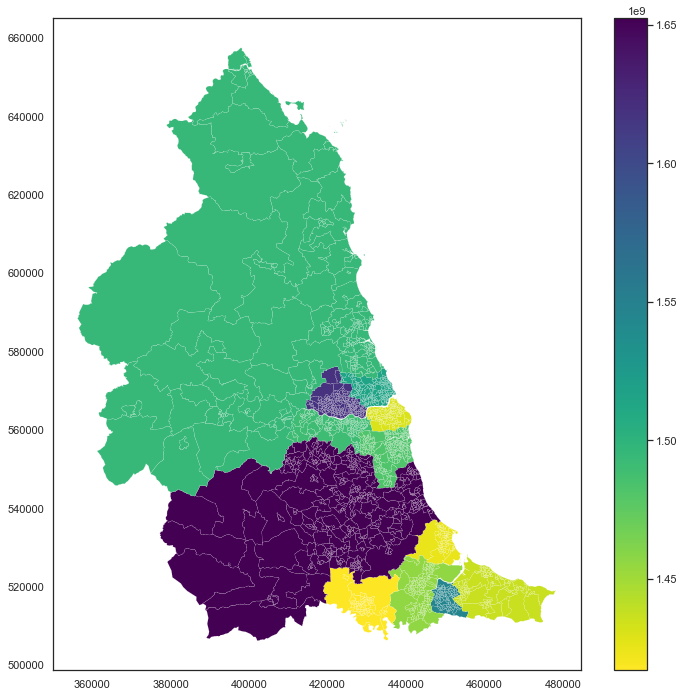

In [91]:
Allgdf_neengland.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

# Looking at South West

In [92]:
Allgdf_swengland = Allgdf[Allgdf['NUTS1 Name'] == "South West (England)"]

gdf_swengland = gdf[gdf['NUTS1 Name'] == "South West (England)"]

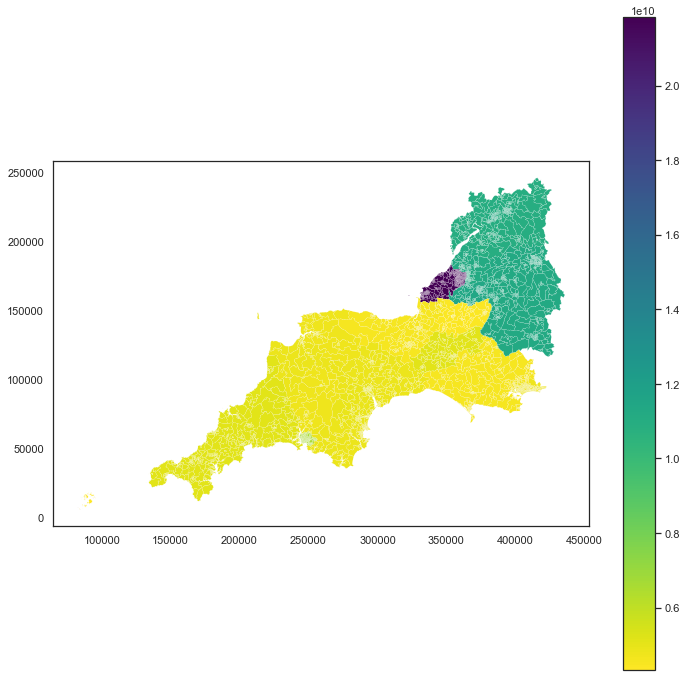

In [93]:
Allgdf_swengland.plot(column='TotalPastValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);

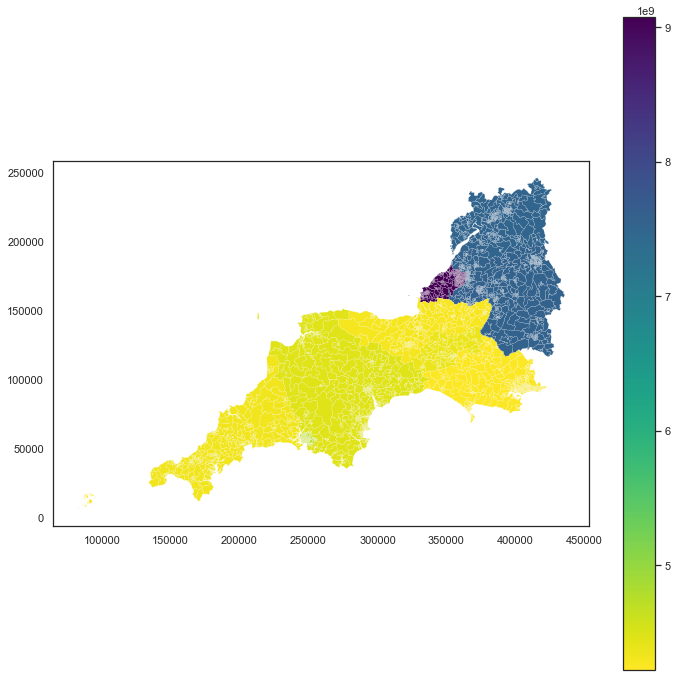

In [94]:
Allgdf_swengland.plot(column='TotalFutureValueSAB', cmap=reversed_color_map, legend=True, figsize=(12,12), linewidth = 0.1);